# This is a pipeline to visualize and analyze the results of CellProfiler on inmunohistochemistry experiments done for PH3


#### TODO:
    - register an a2axai14 line to ARA to separate territories in the ToS
    - register the projections from AUD1 to select the area

In [ ]:
# You need to install these dependencies:
# pip install cp-utils-hmv
# pip install scikit-learn
# pip install dill

In [1]:
# Import stuff
%load_ext autoreload
%autoreload 2
import os
from cp_utils_hmv import data_reader
from cp_utils_hmv import plot_utils
from cp_utils_hmv import generic_functions as gf
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageOps
import numpy as np
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
#from ggplot import *
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import random
from sklearn.preprocessing import StandardScaler
from scipy.stats import norm
import dill
from IPython.display import clear_output
from datetime import date
clear_output()

In [64]:
# Indicate the animal IDs you want to load
animals_to_load = ['PH312']
# Indicate the main path where all processed data is
# processed_data_path = '/mnt/c/Users/herny/Desktop/SWC/Data/Microscopy_Data/Plasticity/PH3_inmuno/Processed_data/'
processed_data_path = '/home/hernandom/data/Microscopy_Data/Plasticity/PH3_inmuno/Processed_data/'

In [65]:
if len(animals_to_load) > 1:
    output_directory = processed_data_path
else:
    output_directory = os.path.join(processed_data_path, animals_to_load[0], 'Analysis')
    if not os.path.exists(output_directory):
        os.mkdir(output_directory)

In [66]:
# loop through the animals to get the dataset
df_list = []
for animal_to_load in animals_to_load:
# get paths
    data_path = os.path.join(processed_data_path, animal_to_load)
    # path where the dataframe is (the output of CellProfiler)
    CPoutput_path = os.path.join(data_path, 'Cell_profiler_output/')
    # Import the data
    df_list.append(data_reader.PH3_data_reader(CPoutput_path))

In [67]:
# concatenate data frames
df = pd.concat(df_list, ignore_index=True)

In [68]:
# Create a unique identifier for every instance of measure (manual ROI)
df['group_name'] = df.apply(gf.group_name, axis=1)
df['manual_roi_name'] = df.apply(gf.manual_roi_name, axis=1)

In [69]:
# Add the data path as an attribute of the dataframe
df.attrs['datapath'] = processed_data_path

In [70]:
# save it
df.to_pickle(os.path.join(output_directory, '-'.join(animals_to_load) + '_df.pkl'))

In [71]:
# Print output for report
print('Date of analysis:', date.today())
print('Output folder:', output_directory)

Date of analysis: 2022-12-15
Output folder: /home/hernandom/data/Microscopy_Data/Plasticity/PH3_inmuno/Processed_data/PH312/Analysis


In [81]:
# read it
df = pd.read_pickle(os.path.join(output_directory, '-'.join(animals_to_load) + '_df.pkl'))
# Add the data path as an attribute of the dataframe because it might have changed computers
df.attrs['datapath'] = processed_data_path

In [11]:
# Rename channels
#df = df.rename(columns={"Children_FinalDots_C2_Count": "drd2_count",
#                        "Children_FinalDots_C3_Count": "drd1_count"})

In [12]:
#OPTIONAL

# Remove some manual ROIs that are not good
# g_names_to_remove = ['PH301-1-5-R-Tail']

# df = df[~df.manual_roi_name.isin(g_names_to_remove)]

In [14]:
df

,AnimalID,ExperimentalCondition,Slide,Slice,Side,AP,ROI,ObjectNumber_cells,I_cell_C2,I_cell_C3,...,I_surround_C2,I_surround_C3,I_surround_C4,Center_X,Center_Y,PathName_Channel1,cellpose_SPN,cellpose_d2,group_name,manual_roi_name
0,PH308,Auditory-PH3,1,0,Both,Caudoputamen,10,1,0.644131,0.212451,...,0.635828,0.241503,0.410119,62.056905,24.972241,/home/hernandom/data/Microscopy_Data/Plasticit...,0,0,PH308-1-0-Both-Caudoputamen-10,PH308-1-0-Both-Caudoputamen
1,PH308,Auditory-PH3,1,0,Both,Caudoputamen,10,2,0.470994,0.083348,...,0.576361,0.146972,0.535908,561.222981,26.931741,/home/hernandom/data/Microscopy_Data/Plasticit...,0,0,PH308-1-0-Both-Caudoputamen-10,PH308-1-0-Both-Caudoputamen
2,PH308,Auditory-PH3,1,0,Both,Caudoputamen,10,3,0.592252,0.149929,...,0.603464,0.210543,0.483213,405.185484,34.288306,/home/hernandom/data/Microscopy_Data/Plasticit...,0,0,PH308-1-0-Both-Caudoputamen-10,PH308-1-0-Both-Caudoputamen
3,PH308,Auditory-PH3,1,0,Both,Caudoputamen,10,4,0.603508,0.371812,...,0.640024,0.318614,0.413605,446.207977,36.156695,/home/hernandom/data/Microscopy_Data/Plasticit...,0,0,PH308-1-0-Both-Caudoputamen-10,PH308-1-0-Both-Caudoputamen
4,PH308,Auditory-PH3,1,0,Both,Caudoputamen,10,5,0.672296,0.444016,...,0.641283,0.338436,0.487757,620.930233,52.295983,/home/hernandom/data/Microscopy_Data/Plasticit...,0,3,PH308-1-0-Both-Caudoputamen-10,PH308-1-0-Both-Caudoputamen
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
98897,PH308,Auditory-PH3,1,9,Both,Caudoputamen,9,177,0.197583,0.106708,...,0.192732,0.113875,0.340827,80.060942,726.444598,/home/hernandom/data/Microscopy_Data/Plasticit...,0,0,PH308-1-9-Both-Caudoputamen-9,PH308-1-9-Both-Caudoputamen
98898,PH308,Auditory-PH3,1,9,Both,Caudoputamen,9,178,0.440004,0.498401,...,0.423302,0.395577,0.381981,731.885196,722.862538,/home/hernandom/data/Microscopy_Data/Plasticit...,25,72,PH308-1-9-Both-Caudoputamen-9,PH308-1-9-Both-Caudoputamen
98899,PH308,Auditory-PH3,1,9,Both,Caudoputamen,9,179,0.332113,0.104681,...,0.312898,0.163768,0.342950,211.396774,725.222581,/home/hernandom/data/Microscopy_Data/Plasticit...,0,0,PH308-1-9-Both-Caudoputamen-9,PH308-1-9-Both-Caudoputamen
98900,PH308,Auditory-PH3,1,9,Both,Caudoputamen,9,180,0.362483,0.220122,...,0.394056,0.275471,0.352003,532.081967,727.402810,/home/hernandom/data/Microscopy_Data/Plasticit...,0,0,PH308-1-9-Both-Caudoputamen-9,PH308-1-9-Both-Caudoputamen


***
### Sanity checks on the data
***

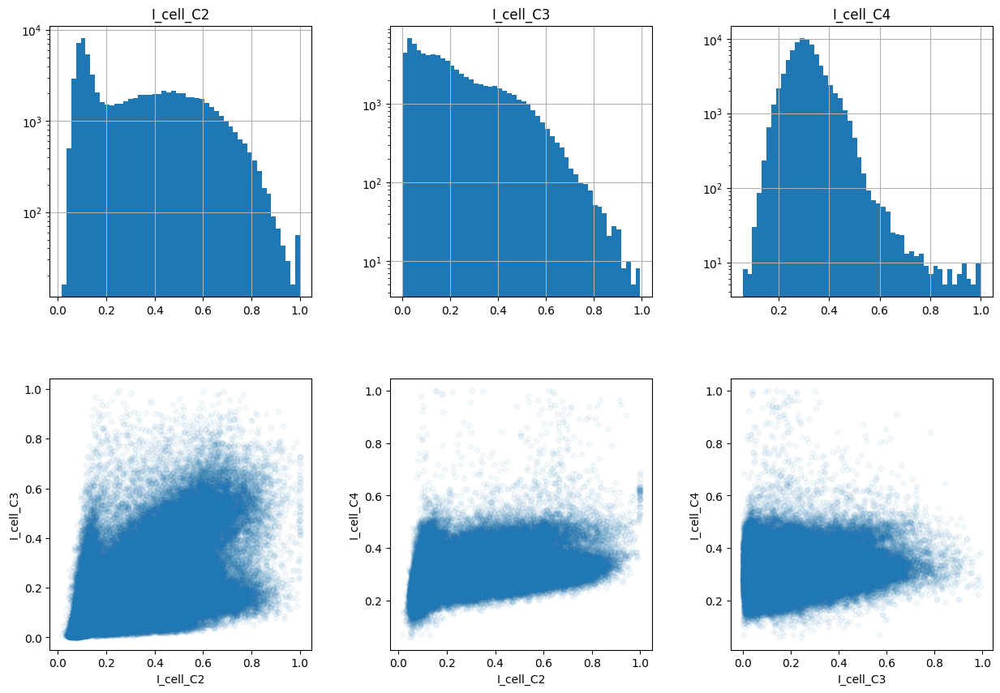

In [82]:
# plot histograms of counts for all the cells
channels = ["I_cell_C2", "I_cell_C3", "I_cell_C4"]
%matplotlib inline
fig, axs = plt.subplots(2, ncols=3, sharey=False, figsize=(15,10))
axs = axs.ravel()
axArr = [axs[0], axs[1], axs[2]]
i = 0
for axis in axArr:
    df.hist(channels[i], ax = axis, bins=50)
    #sns.distplot(df[channels[i]], ax = axis)
    axis.set_yscale("log")
    #axis.set_ylim(0,1000)
    axis.set_title(channels[i])
    i+=1
df.plot.scatter(channels[0], channels[1], ax = axs[3], alpha = 0.05)
df.plot.scatter(channels[0], channels[2], ax = axs[4], alpha = 0.05)
df.plot.scatter(channels[1], channels[2], ax = axs[5], alpha = 0.05)
plt.show()

In [74]:
# # Rescale a channel if needed
# channel_to_rescale = 'C4'
# value_to_rescale = .15
# ch_list = ['I_cell_', 'Istd_cell_', 'I_surround_']
# for ch in ch_list:
#     chtr = ch + channel_to_rescale
#     # rescale
#     df[chtr] = df[chtr] / value_to_rescale
#     # cap
#     idx_to_cap = df[df[chtr] > 1.].index.values
#     df.loc[idx_to_cap, chtr] = 1.
# print('Rescaling channel {} to {}'.format(channel_to_rescale, value_to_rescale))

Rescaling channel C4 to 0.15


In [ ]:
# # plot histograms of counts for all the cells
# channels = ["I_cell_C2", "I_cell_C3", "I_cell_C4"]
# %matplotlib inline
# fig, axs = plt.subplots(2, ncols=3, sharey=False, figsize=(15,10))
# axs = axs.ravel()
# axArr = [axs[0], axs[1], axs[2]]
# i = 0
# for axis in axArr:
#     df.hist(channels[i], ax = axis, bins=50)
#     #sns.distplot(df[channels[i]], ax = axis)
#     axis.set_yscale("log")
#     #axis.set_ylim(0,1000)
#     axis.set_title(channels[i])
#     i+=1
# df.plot.scatter(channels[0], channels[1], ax = axs[3], alpha = 0.05)
# df.plot.scatter(channels[0], channels[2], ax = axs[4], alpha = 0.05)
# df.plot.scatter(channels[1], channels[2], ax = axs[5], alpha = 0.05)
# plt.show()

#### Steps:
- Select SPNs from cellpose
    - Select D1 and D2 from cellpose classification
    - Identify PH3 positive cells

Outputs:
- Quantify the proportion of PH3+ D1 and D2
- Locations of PH3 cells with three categories: D1, D2, spn

In [83]:
# remove rows in which the location of the cells is NaN (I don't know why CellProfiler does this)
print('Removing {}% of nan values'.format(np.sum(np.isnan(df.Center_X))/df.shape[0] * 100))
df.drop(df[np.isnan(df.Center_X)].index, inplace=True)

Removing 0.0% of nan values


### - Select SPNs, from cellpose

In [84]:
SPN_indexes_cp = df[df.cellpose_SPN > 0].index.values

In [73]:
# Remove noise, cells that deviate from the norm

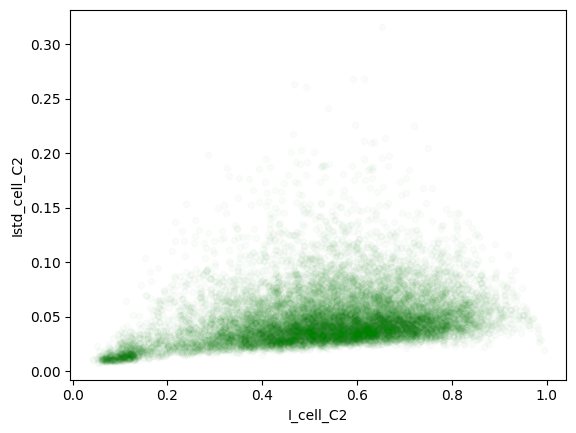

In [85]:
df.loc[SPN_indexes_cp].plot.scatter("I_cell_C2", "Istd_cell_C2", alpha = 0.02, color='green')
plt.show()

/tmp/ipykernel_915022/2723309453.py:11: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


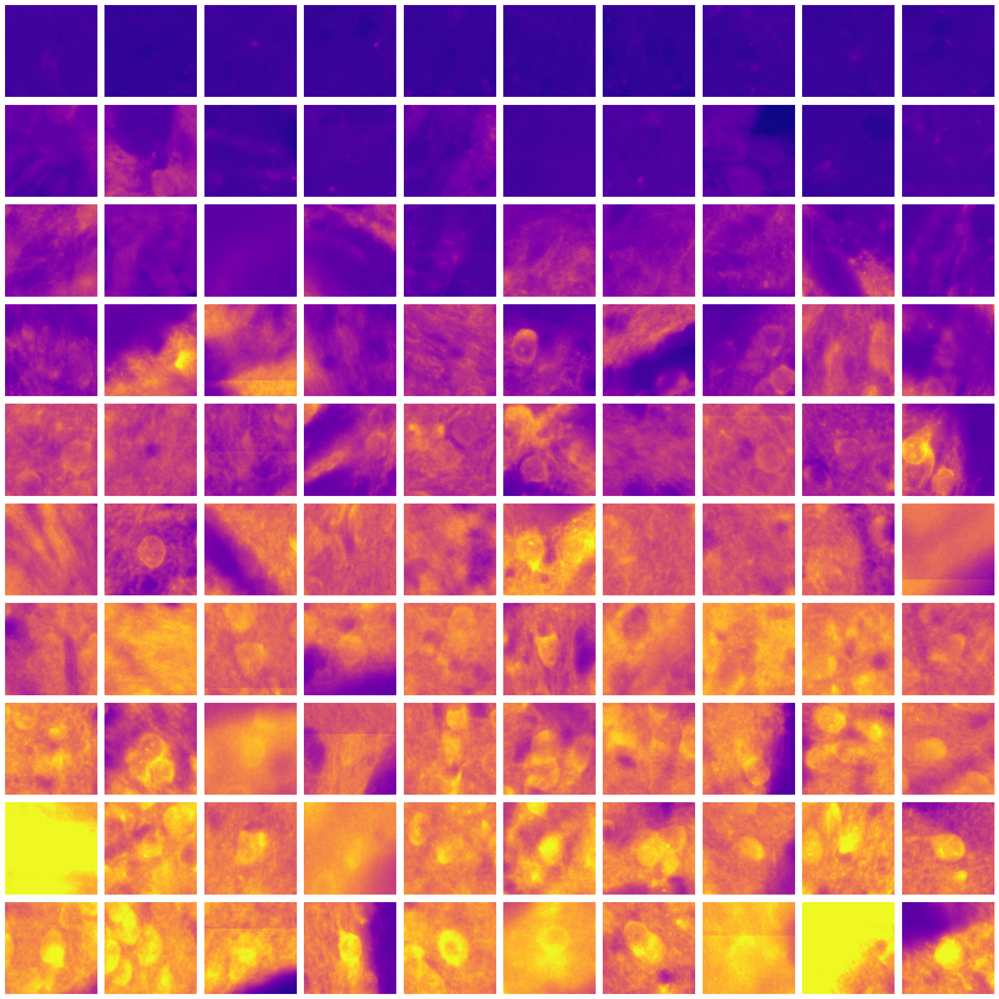

In [86]:
# get indexes to plot
channel = 2
ncells = 10
sc = 'I_cell_C' + str(channel)
thresholds = ((0, .1), (.1, .2), (.2, .3), (.3, .4), (.4, .5),
              (.5, .6), (.6, .7), (.7, .8), (.8, 9), (.9, 1.))
indexes = gf.get_indexes_by_thr(df, sc, thresholds, ncells)
# plot
fig, axs = plt.subplots(len(thresholds), ncells, sharey=False, figsize=(np.ceil(2*ncells), np.ceil(2*len(thresholds))))
fig = plot_utils.plot_channel_of_indexes(fig, axs, indexes, df, channel, window=60, lut='plasma')
fig.show()

In [28]:
from scipy.stats import gaussian_kde as gkde

nan_mask = np.isnan(df.loc[SPN_indexes_cp].I_cell_C2)
mixed_mask = SPN_indexes_cp[-nan_mask]

kx = np.array(df.loc[mixed_mask].I_cell_C2)
ky = np.array(df.loc[mixed_mask].Istd_cell_C2)

kernel = gkde(np.vstack([kx, ky]))

In [29]:
xmin = kx.min()
xmax = kx.max()
ymin = ky.min()
ymax = ky.max()

In [30]:
X, Y = np.mgrid[xmin:xmax:50j, ymin:ymax:50j]
positions = np.vstack([X.ravel(), Y.ravel()])
Z = np.reshape(kernel(positions).T, X.shape)

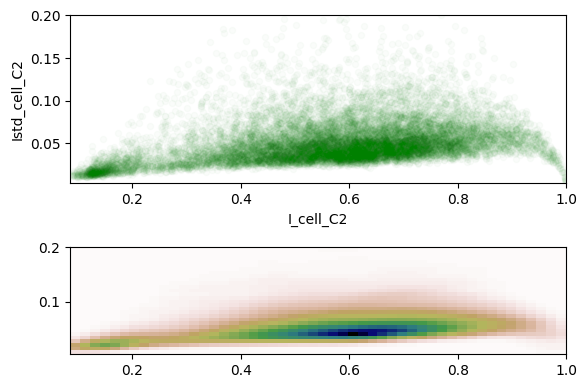

In [52]:
fig, ax = plt.subplots(2,1)
ax=ax.ravel()
df.loc[SPN_indexes_cp].plot.scatter("I_cell_C2", "Istd_cell_C2", alpha = 0.02, color='green', ax=ax[0])
ax[1].imshow(np.rot90(Z), cmap=plt.cm.gist_earth_r,
          extent=[xmin, xmax, ymin, ymax])
# ax.plot(kx, ky, 'k.', markersize=1, alpha=.01)
for a in ax:
    a.set_xlim([xmin, 1])
    a.set_ylim([ymin, .2])
plt.show()

In [32]:
print('Number of SPNs: {}'.format(df.loc[SPN_indexes_cp].shape[0]))

Number of SPNs: 13366


In [33]:
# add another column with the kernel value
df['C2_int_vs_std_kernel'] = df.apply(lambda x: kernel([x.I_cell_C2, x.Istd_cell_C2])[0], axis=1)

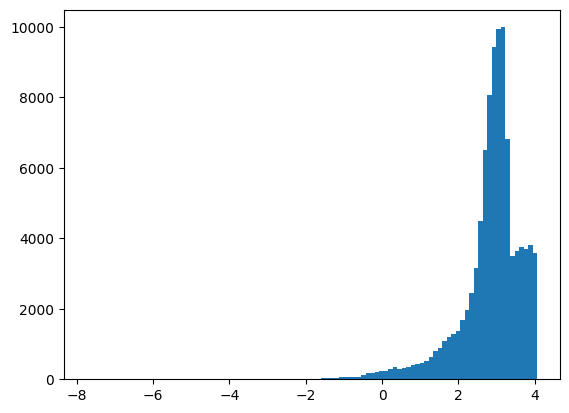

In [46]:
plt.hist(np.log(df.C2_int_vs_std_kernel), bins=100)
# plt.gca().set_xscale('log')
plt.show()

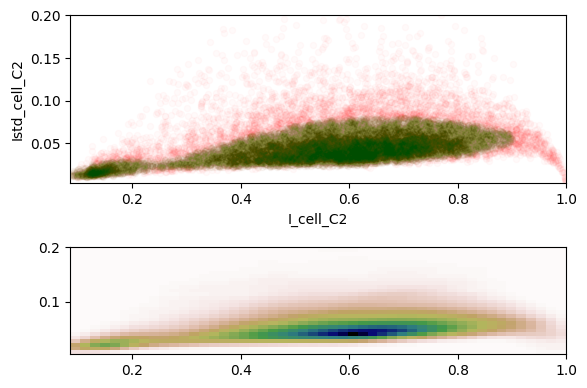

Threshold for kernel: 12.182493960703473
Number of SPNs: 10293
Proportion remaining: 77.0088283704923


In [51]:
# filter points
c2_krnl_thr = 2.5
c2_krnl_thr = np.exp(c2_krnl_thr)
# find indexes of those cells
SPN_indexes_thr = df[df.C2_int_vs_std_kernel >= c2_krnl_thr].index.values
SPN_indexes = np.intersect1d(SPN_indexes_cp, SPN_indexes_thr)

fig, ax = plt.subplots(2,1)
ax=ax.ravel()
df.loc[SPN_indexes_cp].plot.scatter("I_cell_C2", "Istd_cell_C2", alpha = 0.02, color='red', ax=ax[0])
df.loc[SPN_indexes].plot.scatter("I_cell_C2", "Istd_cell_C2", alpha = 0.02, color='green', ax=ax[0])
ax[1].imshow(np.rot90(Z), cmap=plt.cm.gist_earth_r,
          extent=[xmin, xmax, ymin, ymax])
# ax.plot(kx, ky, 'k.', markersize=1, alpha=.01)
for a in ax:
    a.set_xlim([xmin, 1])
    a.set_ylim([ymin, .2])
plt.show()


print('Threshold for kernel: {}\nNumber of SPNs: {}\nProportion remaining: {}'.format(c2_krnl_thr,
                                                                                df.loc[SPN_indexes].shape[0],
                                                                                100 * df.loc[SPN_indexes].shape[0]/df.loc[SPN_indexes_cp].shape[0]))

In [84]:
# see how they look in their inner and outer signal

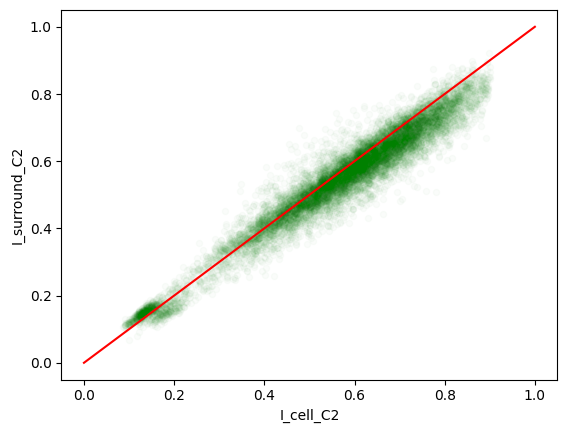

In [53]:
df.loc[SPN_indexes].plot.scatter("I_cell_C2", "I_surround_C2", alpha = 0.02, color='green')
plt.plot([0, 1], [0, 1], '-r')
plt.show()

/tmp/ipykernel_915022/2836421340.py:13: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


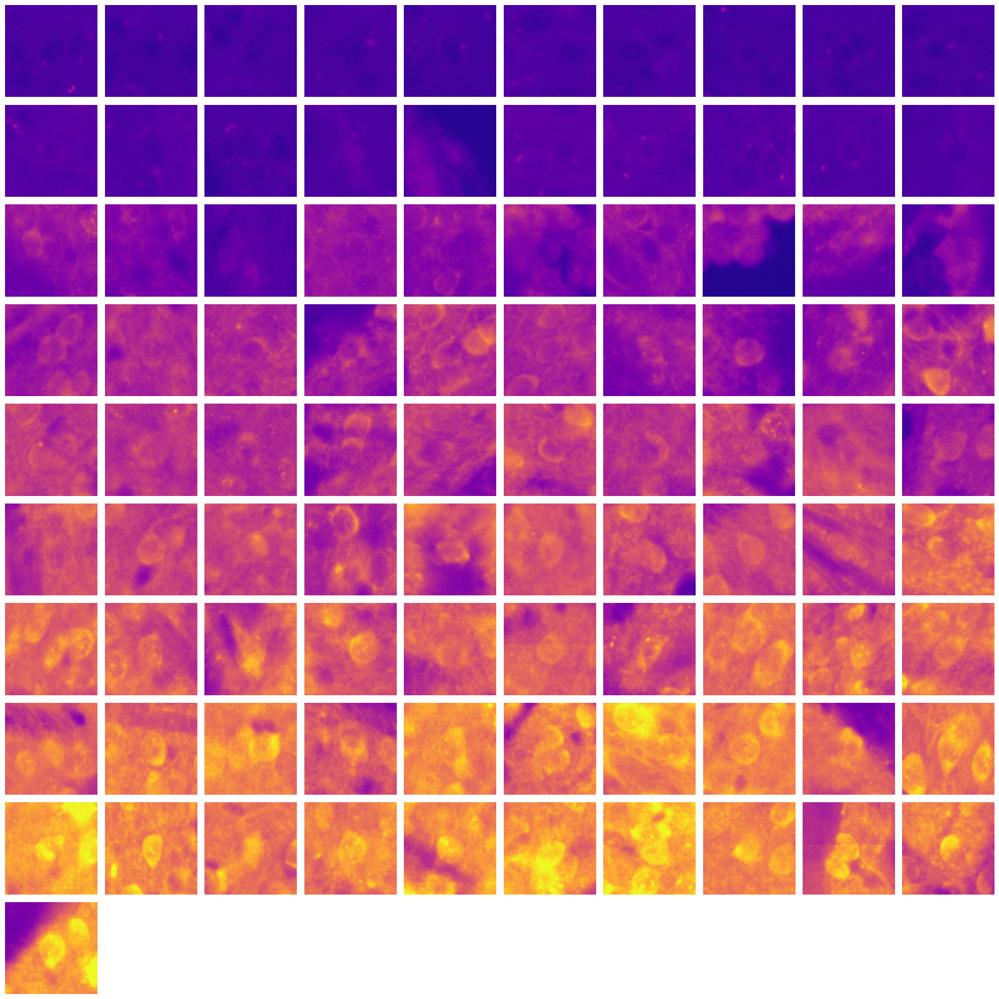

In [54]:
# plot just one channel
channel = 2
ncells = 10
sc = 'I_cell_C' + str(channel)
# plot randomly sets of cells within certain values of channel 2, which is DARPP-32
thresholds = ((0, .1), (.1, .2), (.2, .3), (.3, .4), (.4, .5),
              (.5, .6), (.6, .7), (.7, .8), (.8, 9), (.9, 1.))
# get indexes to plot
indexes = gf.get_indexes_by_thr(df.loc[SPN_indexes], sc, thresholds, ncells)
# plot
fig, axs = plt.subplots(len(thresholds), ncells, sharey=False, figsize=(np.ceil(2*ncells), np.ceil(2*len(thresholds))))
fig = plot_utils.plot_channel_of_indexes(fig, axs, indexes, df, channel, window=60, lut='plasma')
fig.show()

In [55]:
# remove low intensity ones
c2_thr = .3
# find indexes of those cells
SPN_indexes_thr = df[df.I_cell_C2 >= c2_thr].index.values
SPN_indexes = np.intersect1d(SPN_indexes, SPN_indexes_thr)
print('Threshold for SPNs: {}    Number of SPNs: {}'.format(c2_thr, df.loc[SPN_indexes].shape[0]))

Threshold for SPNs: 0.3    Number of SPNs: 9397


In [ ]:
# tests on just SPNs and ph3
# The std is not a good value to use to get rid of cells, at least on the highly expressing ones

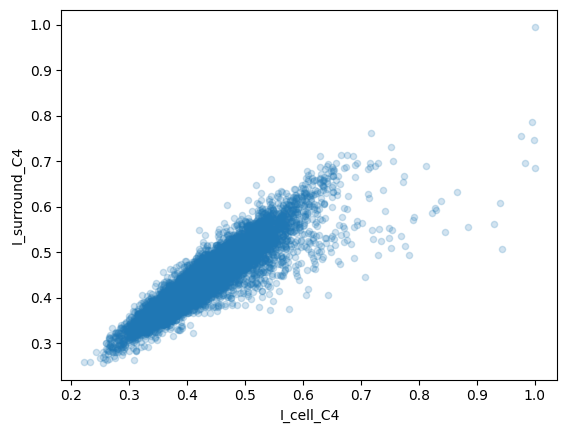

In [56]:
df.loc[SPN_indexes].plot.scatter("I_cell_C4", "I_surround_C4", alpha = 0.2)
# plt.gca().set_xlim([0,.2])
# plt.gca().set_ylim([0,.2])
plt.show()

/tmp/ipykernel_915022/3019519288.py:15: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


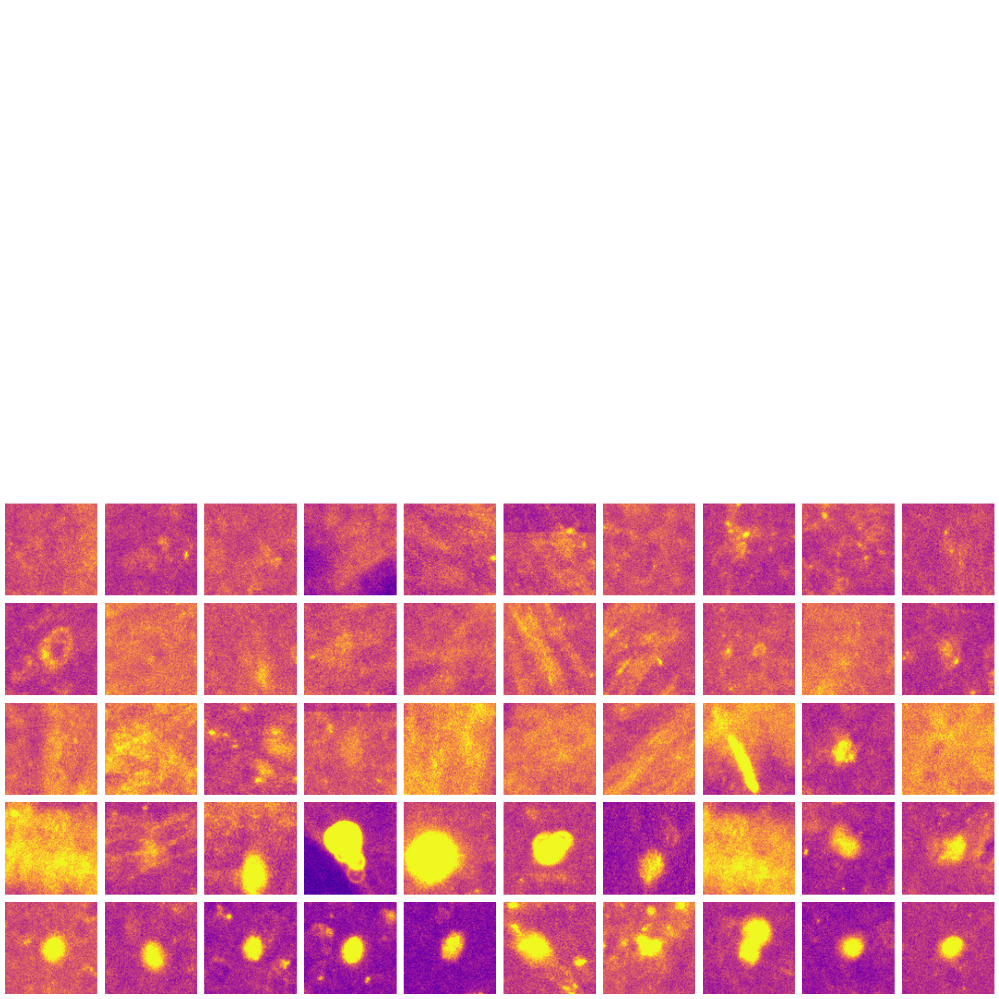

In [57]:
mask_idx = df[df.I_cell_C4 >= .5].index.values

# plot just one channel
channel = 4
ncells = 10
sc = 'I_cell_C4'
# plot randomly sets of cells within certain values of channel 4
thresholds = ((0, .1), (.1, .2), (.2, .3), (.3, .4), (.4, .5),
              (.5, .6), (.6, .7), (.7, .8), (.8, 9), (.9, 1.))
# get indexes to plot
indexes = gf.get_indexes_by_thr(df.loc[mask_idx], sc, thresholds, ncells)
# plot
fig, axs = plt.subplots(len(thresholds), ncells, sharey=False, figsize=(np.ceil(2*ncells), np.ceil(2*len(thresholds))))
fig = plot_utils.plot_channel_of_indexes(fig, axs, indexes, df, channel, window=60, lut='plasma')
fig.show()

In [ ]:
# make another kernel filter

In [137]:
nan_mask = np.isnan(df.loc[SPN_indexes].I_cell_C4)
mixed_mask = SPN_indexes[-nan_mask]

kx = np.array(df.loc[mixed_mask].I_surround_C4)
ky = np.array(df.loc[mixed_mask].Istd_cell_C4)

kernel = gkde(np.vstack([kx, ky]))

In [138]:
xmin = kx.min()
xmax = kx.max()
ymin = ky.min()
ymax = ky.max()
X, Y = np.mgrid[xmin:xmax:50j, ymin:ymax:50j]
positions = np.vstack([X.ravel(), Y.ravel()])
Z = np.reshape(kernel(positions).T, X.shape)

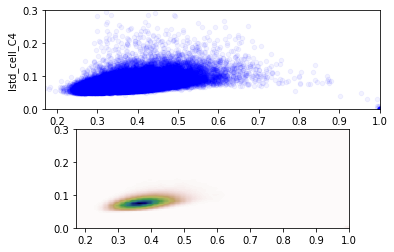

In [143]:
fig, ax = plt.subplots(2,1)
ax=ax.ravel()
df.loc[SPN_indexes].plot.scatter("I_surround_C4", "Istd_cell_C4", alpha = 0.05, color='blue', ax=ax[0])
ax[1].imshow(np.rot90(Z), cmap=plt.cm.gist_earth_r,
          extent=[xmin, xmax, ymin, ymax])
# ax.plot(kx, ky, 'k.', markersize=1, alpha=.01)
for a in ax:
    a.set_xlim([xmin, 1])
    a.set_ylim([ymin, .3])
plt.show()

In [144]:
# add another column with the kernel value
df['C4_surr_vs_std_kernel'] = df.apply(lambda x: kernel([x.I_surround_C4, x.Istd_cell_C4])[0], axis=1)

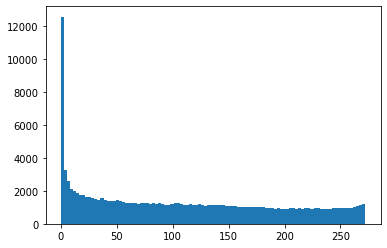

In [152]:
plt.hist((df.C4_surr_vs_std_kernel), bins=100)
# plt.gca().set_xscale('log')
# plt.gca().set_xlim([-1,10])
plt.show()

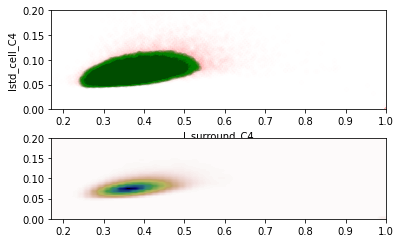

Threshold for kernel: 7
Number of SPNs: 86061
Proportion remaining: 95.24974267594878


In [158]:
# filter points
c4_krnl_thr = 7
# find indexes of those cells
c4_krnl_indexes_thr = df[df.C4_surr_vs_std_kernel >= c4_krnl_thr].index.values
spn_c4_indexes_thr = np.intersect1d(SPN_indexes, c4_krnl_indexes_thr)

fig, ax = plt.subplots(2,1)
ax=ax.ravel()
df.loc[SPN_indexes].plot.scatter("I_surround_C4", "Istd_cell_C4", alpha = 0.002, color='red', ax=ax[0])
df.loc[spn_c4_indexes_thr].plot.scatter("I_surround_C4", "Istd_cell_C4", alpha = 0.02, color='green', ax=ax[0])
ax[1].imshow(np.rot90(Z), cmap=plt.cm.gist_earth_r,
          extent=[xmin, xmax, ymin, ymax])
# ax.plot(kx, ky, 'k.', markersize=1, alpha=.01)
for a in ax:
    a.set_xlim([xmin, 1])
    a.set_ylim([ymin, .2])
plt.show()


print('Threshold for kernel: {}\nNumber of SPNs: {}\nProportion remaining: {}'.format(c4_krnl_thr,
                                                                                df.loc[spn_c4_indexes_thr].shape[0],
                                                                                100 * df.loc[spn_c4_indexes_thr].shape[0]/df.loc[SPN_indexes].shape[0]))

/home/hernandom/.conda/envs/imageanalysis/lib/python3.7/site-packages/ipykernel_launcher.py:15: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  from ipykernel import kernelapp as app


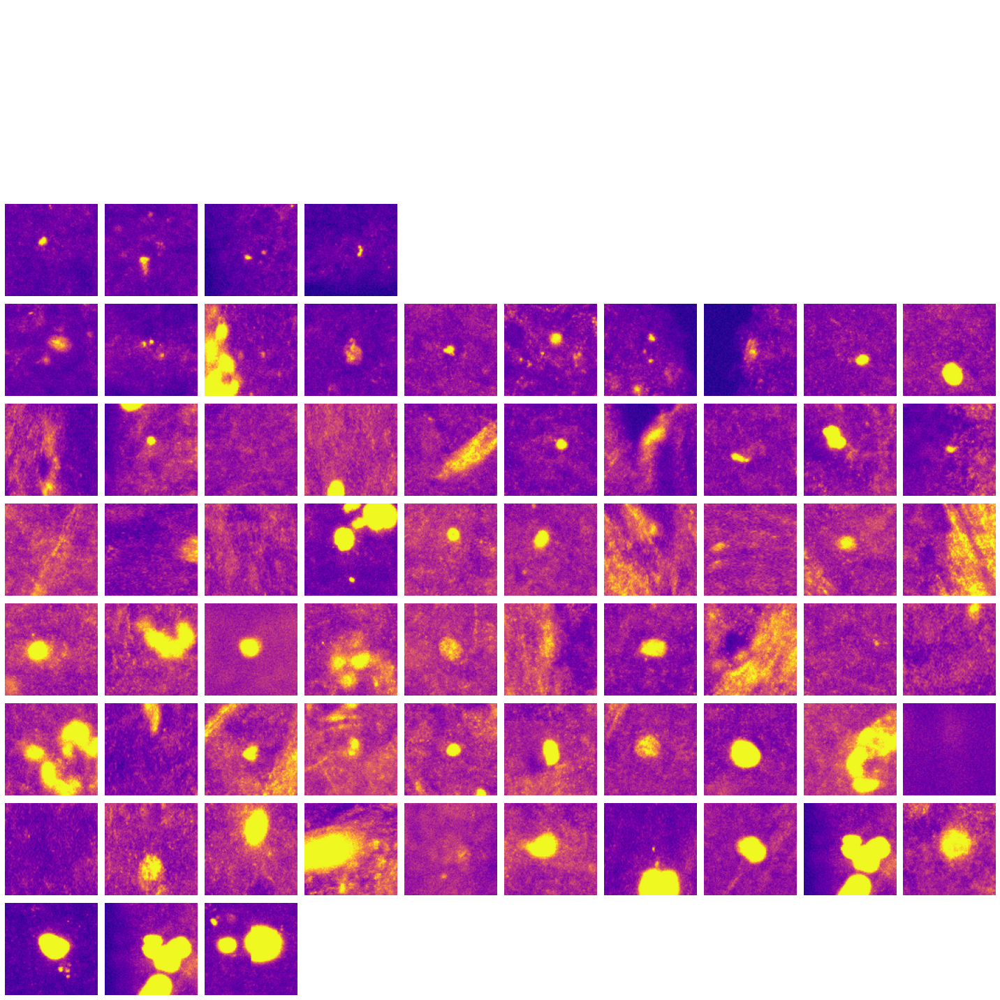

In [165]:
mask_idx = df[df.Istd_cell_C4 >= .17].index.values

# plot just one channel
channel = 4
ncells = 10
sc = 'I_cell_C4'
# plot randomly sets of cells within certain values of channel 4
thresholds = ((0, .1), (.1, .2), (.2, .3), (.3, .4), (.4, .5),
              (.5, .6), (.6, .7), (.7, .8), (.8, 9), (.9, 1.))
# get indexes to plot
indexes = gf.get_indexes_by_thr(df.loc[mask_idx], sc, thresholds, ncells)
# plot
fig, axs = plt.subplots(len(thresholds), ncells, sharey=False, figsize=(np.ceil(2*ncells), np.ceil(2*len(thresholds))))
fig = plot_utils.plot_channel_of_indexes(fig, axs, indexes, df, channel, window=60, lut='plasma')
fig.show()

In [166]:
indexes

[[],
 [],
 [118610, 110679, 121792, 91719],
 [36337, 52719, 114411, 120727, 32451, 128964, 52743, 133968, 98373, 33767],
 [133906, 53319, 88662, 10686, 120229, 53415, 131301, 77455, 128566, 70341],
 [93530, 131009, 131511, 2039, 64580, 113478, 125351, 94214, 22051, 90648],
 [62908, 11671, 44955, 12813, 129893, 123963, 96618, 98290, 93599, 123849],
 [93425, 72995, 128641, 102957, 62051, 18163, 88903, 36066, 59334, 43229],
 [23449, 25457, 18273, 85773, 31037, 72201, 2031, 127129, 53314, 126313],
 [1957, 53314, 130287]]

In [173]:
df.loc[36066]

AnimalID                                                             PH313
ExperimentalCondition                                             Auditory
Slide                                                                    1
Slice                                                                    6
Side                                                                  Both
AP                                                            Caudoputamen
ROI                                                                     63
ObjectNumber_cells                                                      15
I_cell_C2                                                         0.534015
I_cell_C3                                                         0.127803
I_cell_C4                                                         0.709689
Istd_cell_C2                                                       0.09632
Istd_cell_C3                                                      0.029928
Istd_cell_C4             

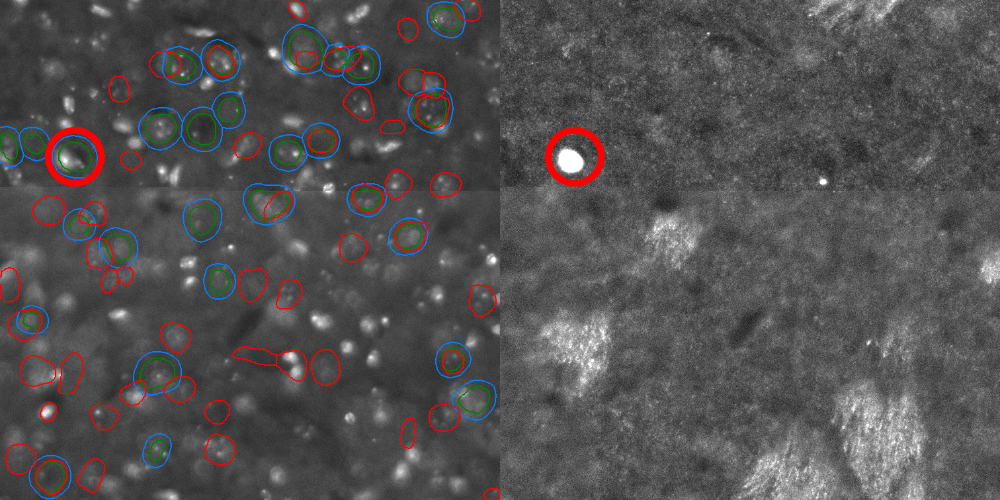

In [174]:
# Circle all cells in a ROI
g_name = 'PH313-1-6-Both-Caudoputamen-63'
# indicate the size of the circle
cir_radius = 40

im = plot_utils.inspect_cells_in_ROI(df=df, indexes_to_plot=[36066], g_name=g_name, channels=[4],
                                     cir_radius=cir_radius, binning=1, tdtomato_thr=-1,
                                     plot_cellprofiler=True)
im

In [160]:
# define the times above the std for significance
sig_crit = 2.5

# Find parameters of the intensities
mu_int = np.mean(df.loc[spn_c4_indexes_thr].I_cell_C4)
std_int = np.std(df.loc[spn_c4_indexes_thr].I_cell_C4)
# Create a new column with the difference between the inside and the outside of the nucleus
df['I_C4_diff'] = df.I_cell_C4 - df.I_surround_C4
# Find parameters of the distribution
mu_diff = np.mean(df.loc[spn_c4_indexes_thr].I_C4_diff)
std_diff = np.std(df.loc[spn_c4_indexes_thr].I_C4_diff)

# apply the selection
# find indexes of PH3 SPNs cells
intensity_mask = df.loc[spn_c4_indexes_thr].I_cell_C4 > mu_int + sig_crit * std_int
PH3_indexes_intensity = spn_c4_indexes_thr[intensity_mask]
difference_mask = df.loc[spn_c4_indexes_thr].I_C4_diff > mu_diff + sig_crit * std_diff
PH3_indexes_difference = spn_c4_indexes_thr[difference_mask]

PH3_indexes = np.intersect1d(PH3_indexes_intensity, PH3_indexes_difference)
df.loc[PH3_indexes].shape

(256, 29)

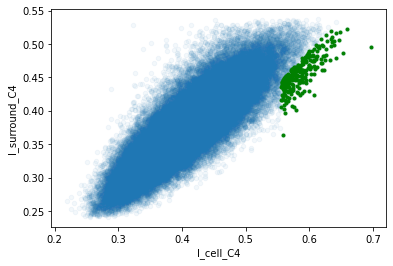

In [163]:
# double check
df.loc[spn_c4_indexes_thr].plot.scatter("I_cell_C4", "I_surround_C4", alpha = 0.050)
plt.plot(df.loc[PH3_indexes].I_cell_C4, df.loc[PH3_indexes].I_surround_C4, '.g')
# c4_point = [0.7, 0.7]
# c4_slope = 1
# xs = np.linspace(np.min(df.I_cell_C4_norm), np.max(df.I_cell_C4_norm), 10)
# zero_int = c4_point[1] - c4_point[0] * c4_slope
# ys = zero_int + xs * c4_slope
# plt.plot(xs, ys, color='orange')
plt.show()

/home/hernandom/.conda/envs/imageanalysis/lib/python3.7/site-packages/ipykernel_launcher.py:13: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  del sys.path[0]


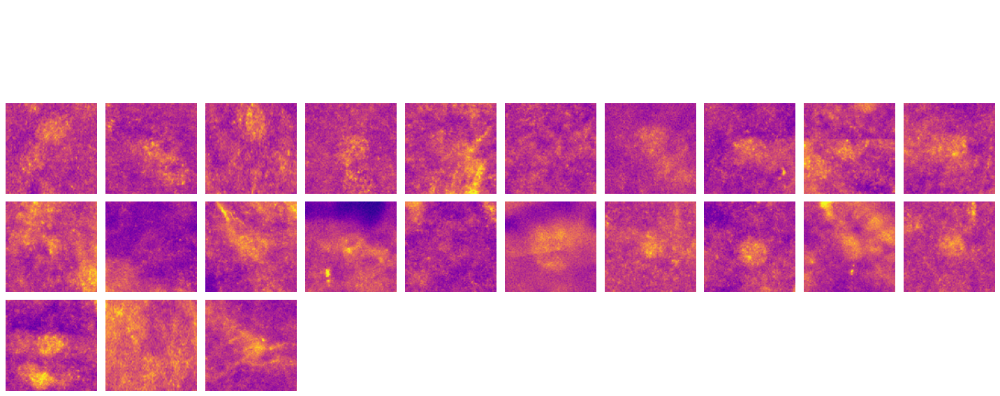

In [164]:
# plot just one channel
channel = 4
ncells = 10
sc = 'I_cell_C4'
# plot randomly sets of cells within certain values of channel 4
thresholds = ((.5, .55), (.55, .6), (.6, .65), (.65, .7))
# thresholds = ((.1, .2), (.2, .3), (.3, .4), (.4, 1))
# get indexes to plot
indexes = gf.get_indexes_by_thr(df.loc[PH3_indexes], sc, thresholds, ncells)
# plot
fig, axs = plt.subplots(len(thresholds), ncells, sharey=False, figsize=(np.ceil(2*ncells), np.ceil(2*len(thresholds))))
fig = plot_utils.plot_channel_of_indexes(fig, axs, indexes, df, channel, window=60, lut='plasma')
fig.show()

### - Select d1 and d2 separately

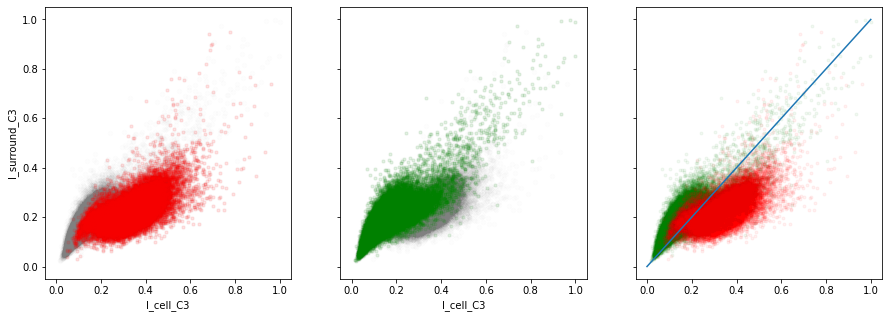

In [29]:
# d2 from cellpose
d2_indexes_cp = df[df.cellpose_d2 > 0].index.values
d2_spn_idx = np.intersect1d(SPN_indexes, d2_indexes_cp)
# d1 from cellpose
d1_spn_idx = np.setdiff1d(SPN_indexes, d2_indexes_cp)

# plot
fig, axs = plt.subplots(1,3,figsize=(15,5), sharey=True, sharex=True)
axs = axs.ravel()

df.loc[SPN_indexes].plot.scatter("I_cell_C3", "I_surround_C3", alpha = 0.01, color ='grey', ax=axs[0])
axs[0].plot(df.loc[d2_spn_idx].I_cell_C3, df.loc[d2_spn_idx].I_surround_C3, '.r', alpha=0.1)

df.loc[SPN_indexes].plot.scatter("I_cell_C3", "I_surround_C3", alpha = 0.01, color ='grey', ax=axs[1])
axs[1].plot(df.loc[d1_spn_idx].I_cell_C3, df.loc[d1_spn_idx].I_surround_C3, '.g', alpha=0.1)

#both
axs[2].plot(df.loc[d1_spn_idx].I_cell_C3, df.loc[d1_spn_idx].I_surround_C3, '.g', alpha=0.05)
axs[2].plot(df.loc[d2_spn_idx].I_cell_C3, df.loc[d2_spn_idx].I_surround_C3, '.r', alpha=0.05)
axs[2].plot([0, 1], [0, 1])

plt.show()

In [30]:
# Option 1: stick with cellpose findings
d1_SPN_indexes = d1_spn_idx
d2_SPN_indexes = d2_spn_idx
print('Selecting d1 and d2 just from cellpose')

Selecting d1 and d2 just from cellpose


In [108]:
# Option 2: select those selected by cellpose and that are above/below the diagonal
d2_SPN_indexes = np.setdiff1d(d2_spn_idx, df[df.I_surround_C3 > df.I_cell_C3].index.values)
d1_SPN_indexes = np.setdiff1d(d1_spn_idx, df[df.I_surround_C3 <= df.I_cell_C3].index.values)
print('Selecting d1 and d2 from cellpose and above / below the diagonal')

Selecting d1 and d2 from cellpose and above / below the diagonal


In [109]:
print('Number of d1 cells: {}'.format(len(d1_SPN_indexes)))
print('Number of d2 cells: {}'.format(len(d2_SPN_indexes)))

Number of d1 cells: 53763
Number of d2 cells: 25477


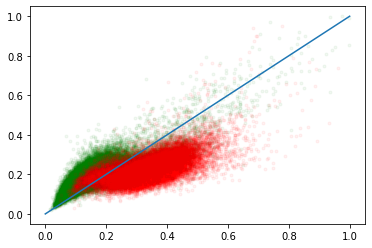

In [31]:
#plot both
plt.plot(df.loc[d1_SPN_indexes].I_cell_C3, df.loc[d1_SPN_indexes].I_surround_C3, '.g', alpha=0.05)
plt.plot(df.loc[d2_SPN_indexes].I_cell_C3, df.loc[d2_SPN_indexes].I_surround_C3, '.r', alpha=0.05)
plt.plot([0, 1], [0, 1])
plt.show()

/home/hernandom/.conda/envs/imageanalysis/lib/python3.7/site-packages/ipykernel_launcher.py:12: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  if sys.path[0] == '':


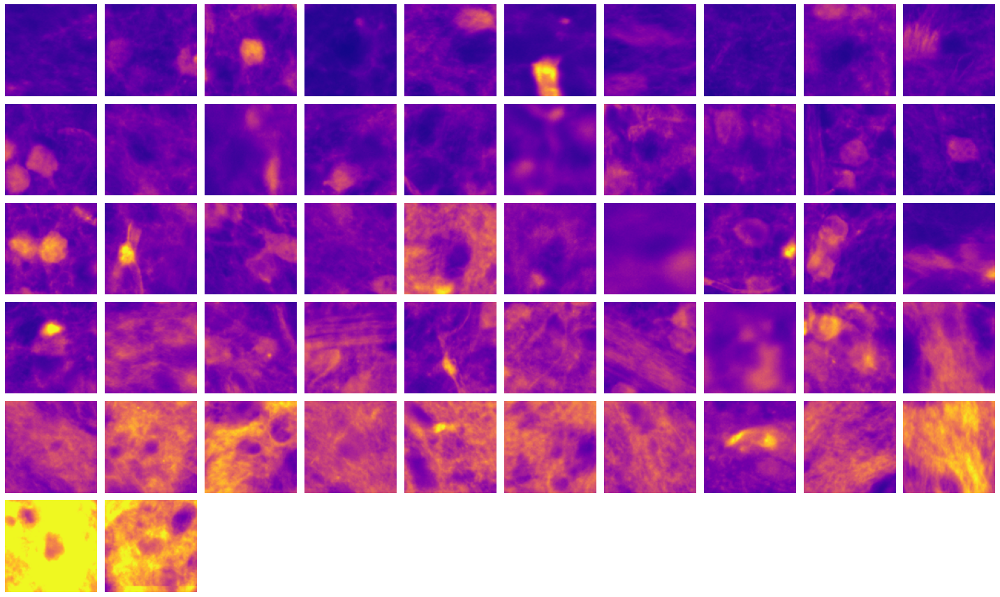

In [111]:
# see the d1 cells
channel = 3
ncells = 10
sc = 'I_cell_C' + str(channel)
# plot randomly sets of cells within certain values 
thresholds = ((0, .1), (.1, .2), (.2, .3), (.3, .4), (.4, .5), (.7,1))
# get indexes to plot
indexes = gf.get_indexes_by_thr(df.loc[d1_SPN_indexes], sc, thresholds, ncells)
# plot
fig, axs = plt.subplots(len(thresholds), ncells, sharey=False, figsize=(np.ceil(2*ncells), np.ceil(2*len(thresholds))))
fig = plot_utils.plot_channel_of_indexes(fig, axs, indexes, df, channel, window=60, lut='plasma')
fig.show()

/home/hernandom/.conda/envs/imageanalysis/lib/python3.7/site-packages/ipykernel_launcher.py:12: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  if sys.path[0] == '':


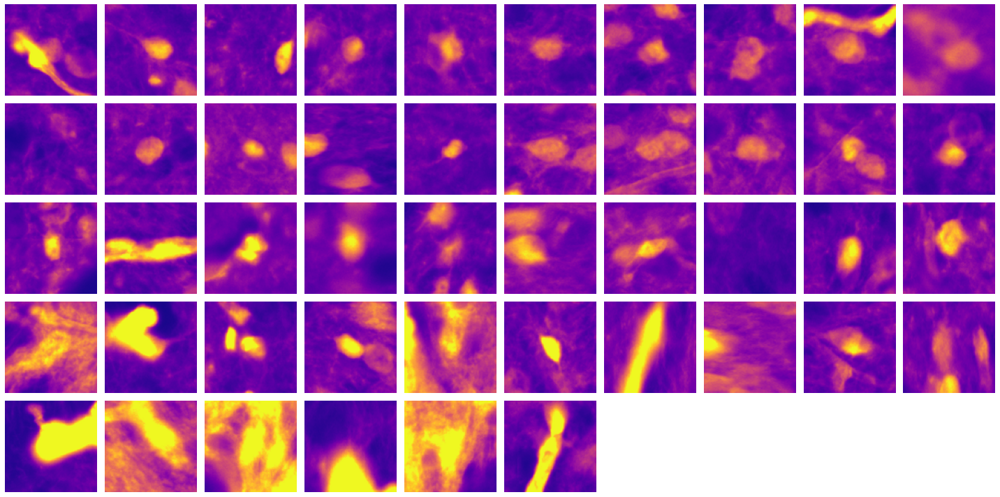

In [112]:
# see the d2 cells
channel = 3
ncells = 10
sc = 'I_cell_C' + str(channel)
# plot randomly sets of cells within certain values of channel 2, which is DARPP-32
thresholds = ((.5, .6), (.6, .7), (.7, .8), (.8, .9), (.9, 1))
# get indexes to plot
indexes = gf.get_indexes_by_thr(df.loc[d2_SPN_indexes], sc, thresholds, ncells)
# plot
fig, axs = plt.subplots(len(thresholds), ncells, sharey=False, figsize=(np.ceil(2*ncells), np.ceil(2*len(thresholds))))
fig = plot_utils.plot_channel_of_indexes(fig, axs, indexes, df, channel, window=60, lut='plasma')
fig.show()

### - Identify PH3+ cells

In [113]:
# select only cells from one slice
# df_bu = df.copy()
# df = df[df.Slide == '1']
# d1_SPN_indexes = np.intersect1d(d1_SPN_indexes, df.index)
# d2_SPN_indexes = np.intersect1d(d2_SPN_indexes, df.index)
# SPN_indexes = np.intersect1d(SPN_indexes, df.index)

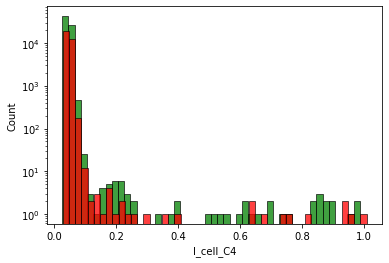

In [32]:
# plot the profiles of the d1 and d2 over the ph3 intensity
splot = sns.histplot(data=df.loc[d1_SPN_indexes], x='I_cell_C4', color='green', binwidth=.02)
sns.histplot(data=df.loc[d2_SPN_indexes], x='I_cell_C4', color='red', binwidth=.02)
SPN_undetermined = SPN_indexes[np.logical_and(~np.in1d(SPN_indexes, d1_SPN_indexes), ~np.in1d(SPN_indexes, d2_SPN_indexes))]
sns.histplot(data=df.loc[SPN_undetermined], x='I_cell_C4', color='grey', binwidth=.02)
splot.set(yscale="log")
plt.show()

In [25]:
# # see the undetermined cells
# ncells = 10
# shuffledIdx = df.loc[SPN_undetermined][df.loc[SPN_undetermined].I_cell_C4 > 0.9].index.values.copy()
# # shuffle them
# np.random.shuffle(shuffledIdx)
# shuffledIdx = shuffledIdx[0:ncells]
# fig = plt.subplots(sharey=False, figsize=(15,np.ceil(2*ncells)))
# for counter, i in enumerate(shuffledIdx):
#     CellImage = plot_utils.plotPH3Cell(df.loc[i], os.path.join(processed_data_path, df.loc[i].AnimalID),
#                                        window=60, lut='plasma')
#     plt.subplot(ncells, 1, counter+1)
#     plt.grid(False)
#     plt.axis('off')
#     plt.title(str(i))
#     plt.imshow(CellImage)

In [24]:
# THIS NORMALIZATION STEP WILL REMOVE THOSE CELLS THAT ARE NOT SELECTED AS D1 OR D2
# They can get selected back if needed
print('Running normalization')
# Normalize the data as the tdTomato channel might be leaking into the PH3 one
df['I_cell_C4_norm'] = np.nan
df.at[d2_SPN_indexes, 'I_cell_C4_norm'] = df.loc[d2_SPN_indexes].I_cell_C4 - np.median(df.loc[d2_SPN_indexes].I_cell_C4)
df.at[d1_SPN_indexes, 'I_cell_C4_norm'] = df.loc[d1_SPN_indexes].I_cell_C4 - np.median(df.loc[d1_SPN_indexes].I_cell_C4)

Running normalization


In [33]:
# NOT RUNNING THE NORMALIZATION
print('NOT Running normalization')
df['I_cell_C4_norm'] = np.nan
df.at[d2_SPN_indexes, 'I_cell_C4_norm'] = df.loc[d2_SPN_indexes].I_cell_C4
df.at[d1_SPN_indexes, 'I_cell_C4_norm'] = df.loc[d1_SPN_indexes].I_cell_C4

NOT Running normalization


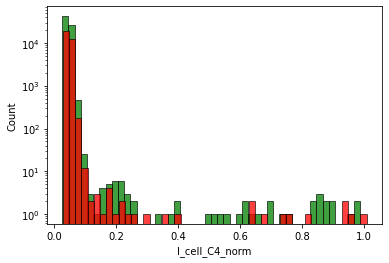

In [34]:
splot = sns.histplot(data=df.loc[d1_SPN_indexes], x='I_cell_C4_norm', color='green', binwidth=.02)
sns.histplot(data=df.loc[d2_SPN_indexes], x='I_cell_C4_norm', color='red', binwidth=.02)
SPN_undetermined = SPN_indexes[np.logical_and(~np.in1d(SPN_indexes, d1_SPN_indexes), ~np.in1d(SPN_indexes, d2_SPN_indexes))]
# sns.histplot(data=df.loc[SPN_undetermined], x='I_cell_C4_norm', color='grey', binwidth=.02)
splot.set(yscale="log")
plt.show()

In [117]:
# Find significant points on the two axis

In [35]:
# define the times above the std for significance
sig_crit = 2.5

# Find parameters of the intensities
mu_int = np.mean(df.loc[SPN_indexes].I_cell_C4_norm)
std_int = np.std(df.loc[SPN_indexes].I_cell_C4_norm)
# Create a new column with the difference between the inside and the outside of the nucleus
df['I_C4_diff'] = df.I_cell_C4_norm - df.I_surround_C4
# Find parameters of the distribution
mu_diff = np.mean(df.loc[SPN_indexes].I_C4_diff)
std_diff = np.std(df.loc[SPN_indexes].I_C4_diff)

# apply the selection
# find indexes of PH3 SPNs cells
intensity_mask = df.loc[SPN_indexes].I_cell_C4_norm > mu_int + sig_crit * std_int
PH3_indexes_intensity = SPN_indexes[intensity_mask]
difference_mask = df.loc[SPN_indexes].I_C4_diff > mu_diff + sig_crit * std_diff
PH3_indexes_difference = SPN_indexes[difference_mask]

PH3_indexes = np.intersect1d(PH3_indexes_intensity, PH3_indexes_difference)
df.loc[PH3_indexes].shape

(50, 28)

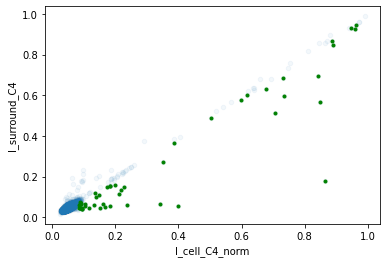

In [36]:
# double check
df.loc[SPN_indexes].plot.scatter("I_cell_C4_norm", "I_surround_C4", alpha = 0.050)
plt.plot(df.loc[PH3_indexes].I_cell_C4_norm, df.loc[PH3_indexes].I_surround_C4, '.g')
# c4_point = [0.7, 0.7]
# c4_slope = 1
# xs = np.linspace(np.min(df.I_cell_C4_norm), np.max(df.I_cell_C4_norm), 10)
# zero_int = c4_point[1] - c4_point[0] * c4_slope
# ys = zero_int + xs * c4_slope
# plt.plot(xs, ys, color='orange')
plt.show()

/home/hernandom/.conda/envs/imageanalysis/lib/python3.7/site-packages/ipykernel_launcher.py:13: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  del sys.path[0]


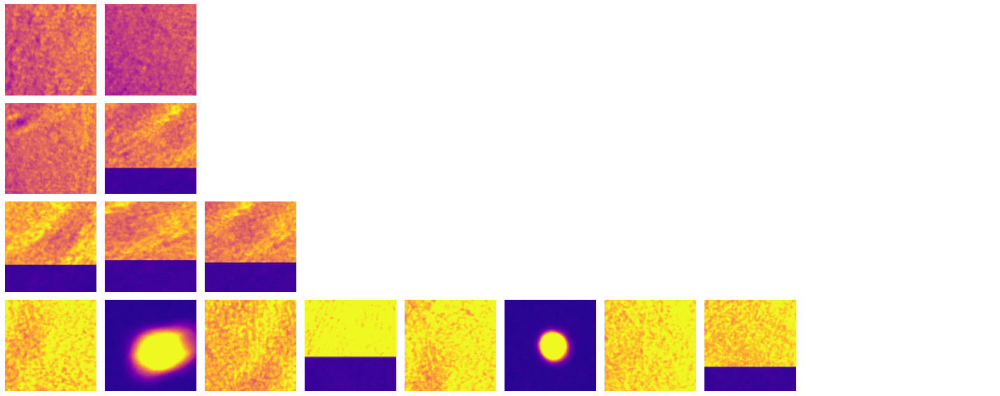

In [37]:
# plot just one channel
channel = 4
ncells = 10
sc = 'I_cell_C4_norm'
# plot randomly sets of cells within certain values of channel 4
thresholds = ((.5, .6), (.6, .7), (.7, .8), (.8, 1))
# thresholds = ((.1, .2), (.2, .3), (.3, .4), (.4, 1))
# get indexes to plot
indexes = gf.get_indexes_by_thr(df.loc[PH3_indexes], sc, thresholds, ncells)
# plot
fig, axs = plt.subplots(len(thresholds), ncells, sharey=False, figsize=(np.ceil(2*ncells), np.ceil(2*len(thresholds))))
fig = plot_utils.plot_channel_of_indexes(fig, axs, indexes, df, channel, window=60, lut='plasma')
fig.show()

In [121]:
# total number of PH3 cells
print("There are {} SPN PH3+ cells".format(len(PH3_indexes)))
# total number of d1+ PH3 cells
d1_SPN_PH3_indexes = np.intersect1d(PH3_indexes, d1_SPN_indexes)
print("There are {} d1 + cells".format(len(d1_SPN_PH3_indexes)))
# total number of d2+ PH3 cells
d2_SPN_PH3_indexes = np.intersect1d(PH3_indexes, d2_SPN_indexes)
print("There are {} d2 + cells".format(len(d2_SPN_PH3_indexes)))

# TODO: show enrichment. Normalize by total number of cells selected

There are 309 SPN PH3+ cells
There are 170 d1 + cells
There are 139 d2 + cells


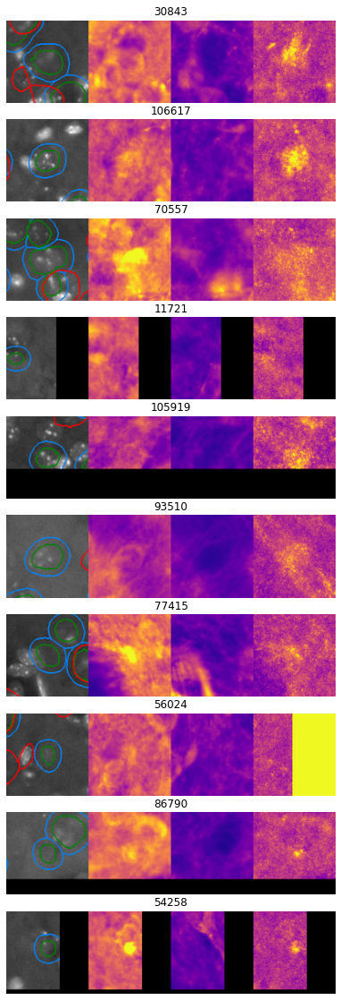

In [76]:
# plot some of the d1 cells
ncells = 10
shuffledIdx = df.loc[d1_SPN_PH3_indexes].index.values.copy()
# shuffle them
np.random.shuffle(shuffledIdx)
shuffledIdx = shuffledIdx[0:ncells]
fig = plt.subplots(sharey=False, figsize=(15,np.ceil(2*ncells)))
for counter, i in enumerate(shuffledIdx):
    CellImage = plot_utils.plotPH3Cell(df.loc[i], os.path.join(processed_data_path, df.loc[i].AnimalID),
                                       window=60, lut='plasma')
    plt.subplot(ncells, 1, counter+1)
    plt.grid(False)
    plt.axis('off')
    plt.title(str(i))
    plt.imshow(CellImage)

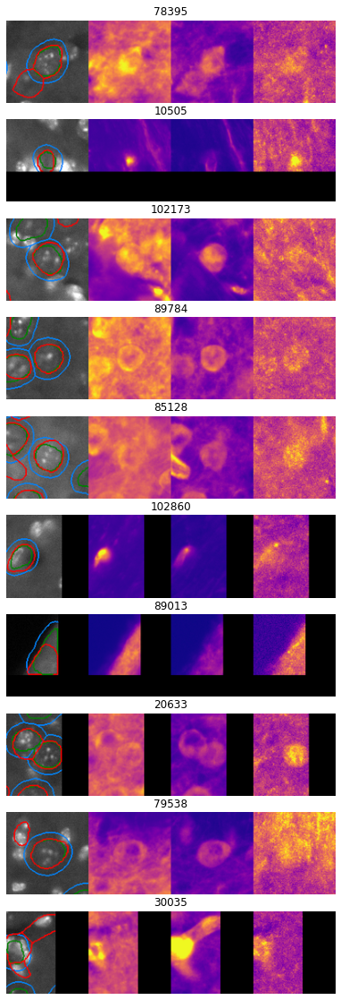

In [77]:
# plot some of the d2 cells
ncells = 10
shuffledIdx = df.loc[d2_SPN_PH3_indexes].index.values.copy()
# shuffle them
np.random.shuffle(shuffledIdx)
shuffledIdx = shuffledIdx[0:ncells]
fig = plt.subplots(sharey=False, figsize=(15,np.ceil(2*ncells)))
for counter, i in enumerate(shuffledIdx):
    CellImage = plot_utils.plotPH3Cell(df.loc[i], os.path.join(processed_data_path, df.loc[i].AnimalID),
                                       window=60, lut='plasma')
    plt.subplot(ncells, 1, counter+1)
    plt.grid(False)
    plt.axis('off')
    plt.title(str(i))
    plt.imshow(CellImage)

In [32]:
# save summary figures with the detections


### Save results

In [39]:
# save the dataframe with the SPN information to calculate, grouping mice together,
# the ph3 positive cells that are d1 or d2 (normalization would have to be done per mouse)
# create columns
df['SPN'] = 0
df.at[SPN_indexes, 'SPN'] = 1
df['d1'] = 0
df.at[d1_SPN_indexes, 'd1'] = 1
df['d2'] = 0
df.at[d2_SPN_indexes, 'd2'] = 1
df['PH3'] = 0
df.at[PH3_indexes, 'PH3'] = 1
# save indexes for going back if necessary
df['df_indexes'] = df.index.values

df.to_pickle(os.path.join(output_directory, '-'.join(animals_to_load) + '_all_cells.pkl'))

In [40]:
# make a dataframe with only the ph3 for plotting them in the atlas
df_ph3 = df.loc[PH3_indexes]
# create new column
df_ph3['cell_label'] = 'undetermined'
df_ph3.at[PH3_indexes, 'cell_label'] = 'spn'
df_ph3.at[d1_SPN_PH3_indexes, 'cell_label'] = 'd1'
df_ph3.at[d2_SPN_PH3_indexes, 'cell_label'] = 'd2'

In [41]:
# get the ARA location of the cells, in millimeters
for idx in df_ph3.index:
    ARA_location = gf.register_cell_to_ARA(df_ph3.loc[idx], df_ph3.attrs['datapath'])
    df_ph3.at[idx, 'ARA_ap'] = ARA_location[0]
    df_ph3.at[idx, 'ARA_dv'] = ARA_location[1]
    df_ph3.at[idx, 'ARA_ml'] = ARA_location[2] # this coordinate is flipped

In [42]:
# save relevant information for Fiji macro (see Fiji Custom repo - Display_points_in_ARA_mm.ijm)
# subselect dataframe
df_tr = df_ph3[['ARA_ap', 'ARA_dv', 'ARA_ml', 'cell_label', 'df_indexes']]
# save output as csv
df_tr.to_csv(os.path.join(output_directory, '-'.join(animals_to_load) + '_ph3_cells_ARA_coordinates.csv'),
             index=False)

In [43]:
# save dataframe
df_ph3.to_pickle(os.path.join(output_directory, '-'.join(animals_to_load) + '_ph3_cells.pkl'))

In [44]:
# save the workspace
dill.dump_session(os.path.join(output_directory, '-'.join(animals_to_load) + '.db'))

# transform to a report using this:
convertion_string = 'jupyter nbconvert --to html --no-input '+\
                os.path.join(os.path.abspath(''), 'Inmuno_4channels_analysis.ipynb') +\
                ' --output ' + os.path.join(output_directory, '-'.join(animals_to_load)) + '.html'
os.system(convertion_string)
clear_output()


## explore and visualize data

In [116]:
# TODO: load here the data after saving


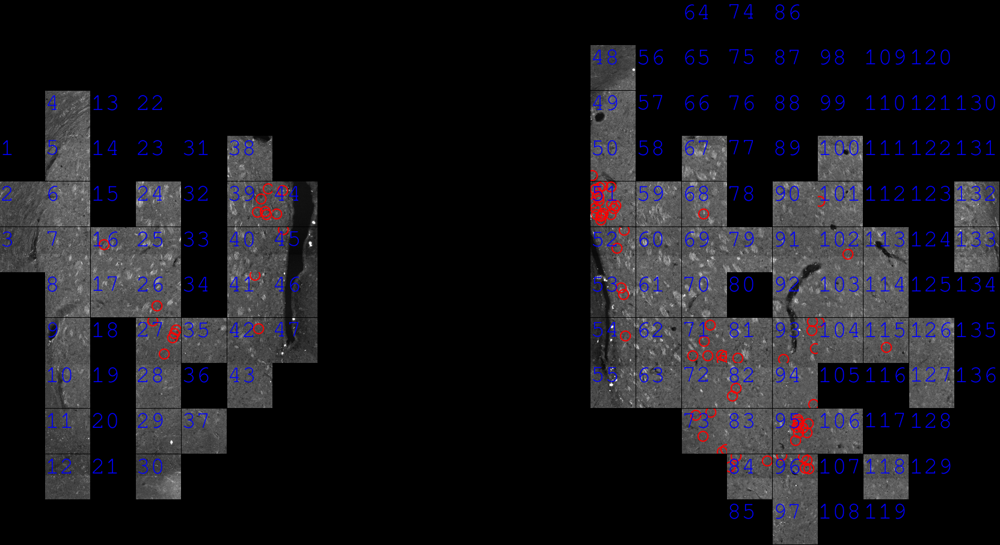

In [113]:
# Concatenate all the ROIs from one manual slice and show the identified cells

# set the conditions to get the data of one of the ROIs
sel_animal = 'PH314'
sel_slide = '1'
sel_slice = '0'
sel_side = 'Both'
sel_ap = 'Caudoputamen'

sel_mroi_name = '-'.join([sel_animal, sel_slide, sel_slice, sel_side, sel_ap])

# regenerate the picture from the square ROIs
im = plot_utils.get_concat_image_from_rois(df_raw=df, indexes_to_plot=SPN_indexes, sel_mroi_name=sel_mroi_name,
                                           channel=4, cir_radius=80, binning=10, tdtomato_thr=-1,
                                           data_path=processed_data_path)
im

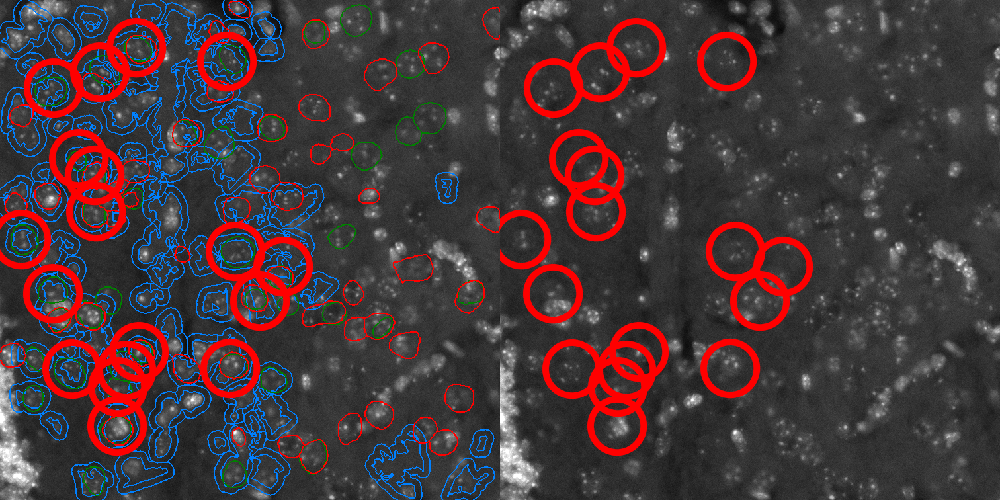

In [115]:
# Circle all cells in a ROI
g_name = 'PH314-1-0-Both-Caudoputamen-51'
# indicate the size of the circle
cir_radius = 40

im = plot_utils.inspect_cells_in_ROI(df=df, indexes_to_plot=SPN_indexes, g_name=g_name, channels=[1],
                                     cir_radius=cir_radius, binning=1, tdtomato_thr=-1,
                                     plot_cellprofiler=True)
im

In [ ]:
# plot the IDs for every object in a ROI

objects_im = plot_utils.show_object_ids(df, g_name, 30)
objects_im

In [ ]:
cellid = 18494
plot_utils.plotPH3Cell(df.loc[cellid], df.attrs['datapath'], window=130, lut='plasma')

## Significance

In [23]:
# calculate the significance of finding these biases for d1
# for each mouse, draw cells randomly from the spn population and compute the p value

In [2]:
# load dataframes here TODO
# Indicate the animal IDs you want to load
animals_to_load = ['PH307', 'PH308', 'PH310', 'PH309', 'PH311', 'PH312']
animals_to_load = animals_to_load + [''.join(['VarS', str(x)]) for x in range(1,6)]
animals_to_load = animals_to_load + ['HighSil2', 'HighSil4']
# Indicate the main path where all processed data is
processed_data_path = '/home/hernandom/data/Microscopy_Data/Plasticity/PH3_inmuno/Processed_data/'

In [3]:
# loop through the animals to get the dataset
df_list = []
for animal_to_load in animals_to_load:
# get paths
    output_directory = os.path.join(processed_data_path, animal_to_load, 'Analysis')
    # read it
    df = pd.read_pickle(os.path.join(output_directory, animal_to_load + '_all_cells.pkl'))
    # Add the data path as an attribute of the dataframe because it might have changed computers
    df.attrs['datapath'] = processed_data_path
    # append
    df_list.append(df)
# concatenate data frames
df = pd.concat(df_list, ignore_index=True)

In [4]:
# load the initial dataset
first_batch_df = pd.read_pickle(os.path.join(processed_data_path, 'PH301-PH302-PH303-PH304-PH305-PH306_all_cells.pkl'))

In [5]:
# concatenate data frames
df = pd.concat([df, first_batch_df], ignore_index=True)

In [6]:
# random iterations to calculate random distribution of proportions
nboot = 1000
# initialize list to save the p_values
pval_list = []

# iterate through the animals
for an_id in df.AnimalID.unique():
    # subset the dataframe
    an_spn_df = df[np.logical_and(df.SPN==1, df.AnimalID==an_id)].reset_index()
    # number of ph3 cells
    n_ph3 = an_spn_df.PH3.sum()
    # initiate array to store random proportions
    rand_prop_list = np.zeros(nboot)
    # iterate
    for i in range(nboot):
        # random sample of cells
        sub_df = an_spn_df.sample(n_ph3)
        # append the proportion of d1 cells to the list
        rand_prop_list[i] = sub_df.d1.mean()

    # mean and std of distribution of random proportions
    rp_mu = np.mean(rand_prop_list)
    rp_std = np.std(rand_prop_list)
    # real proportion of d1 ph3 cells for this animal
    obs_value = an_spn_df[an_spn_df.PH3==1].d1.mean()
    # calculate the z score
    z_val = (obs_value - rp_mu) / rp_std
    # calculate the p value
    p_val = norm.sf(abs(z_val))
    # append to list
    pval_list.append(p_val)

#### Proportion of cells

In [7]:
all_sub = df[df.SPN==1].groupby(['AnimalID'])['d1', 'd2'].mean()
all_sub = all_sub.reset_index()
all_sub = all_sub.melt(id_vars=["AnimalID"], 
                       var_name="cell type", 
                       value_name="proportion")

/home/hernandom/.conda/envs/imageanalysis/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.


In [8]:
ph3_sub = df[df.PH3==1].groupby(['AnimalID'])['d1', 'd2'].mean()
ph3_sub = ph3_sub.reset_index()
ph3_sub = ph3_sub.melt(id_vars=["AnimalID"], 
                       var_name="cell type", 
                       value_name="proportion")

/home/hernandom/.conda/envs/imageanalysis/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.


In [9]:
all_sub['dataset'] = 'all cells'
ph3_sub['dataset'] = 'ph3 cells'
bp_df = pd.concat([all_sub, ph3_sub])

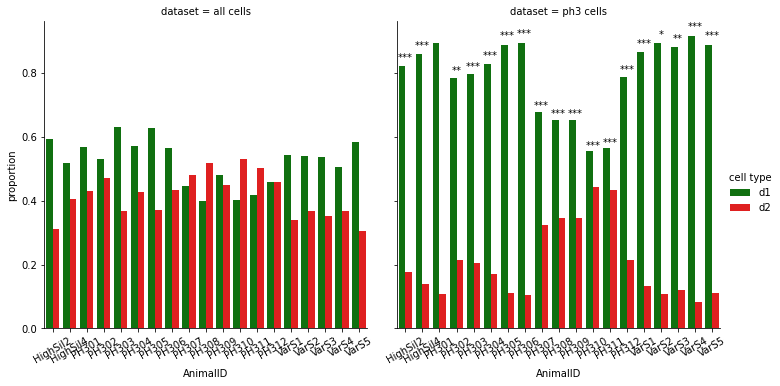

1 asterisks: pval < 0.05
2 asterisks: pval < 0.01
3 asterisks: pval < 0.001


In [10]:
sns.set_palette(['green','red'])
fg_fig = sns.catplot(data=bp_df, x='AnimalID', y='proportion', hue='cell type', col='dataset', kind='bar')
# add the statistical test
# define three levels of significance for the plotting
sig_levels = [0.05, 0.01, 0.001]
# get the axis of where the significance needs to be
sig_ax = fg_fig.axes[0][1]
# get the y position of where the significance labels need to be
# draw the asterisks
for i, an in enumerate(bp_df.AnimalID.unique()):
    n_ast = sum(pval_list[i] < sig_levels)
    ast_str = n_ast * '*'
    sub_bd_df = bp_df[np.logical_and(bp_df.AnimalID == an, bp_df['cell type']=='d1')]
    yval = sub_bd_df[sub_bd_df.dataset == 'ph3 cells'].proportion * 1.03
    sig_ax.text(i, yval, ast_str, horizontalalignment='center', verticalalignment='center')

# rotate labels
for ax in fg_fig.axes[0]:
    ax.set_xticklabels(ax.get_xticklabels(),rotation = 30)
                   
plt.savefig(processed_data_path + 'Proportion_bar-graph.pdf', transparent=True, bbox_inches='tight')
plt.show()

for i,s in enumerate(sig_levels):
    print(i+1, 'asterisks: pval <', s)



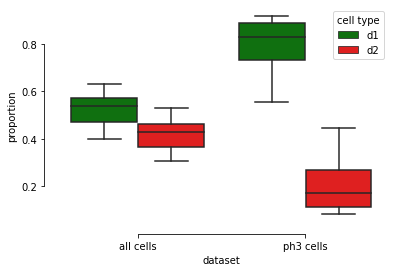

In [11]:
# Draw a nested boxplot
sns.boxplot(x="dataset", y="proportion",
            hue="cell type",# palette=["m", "g"],
            data=bp_df)
sns.despine(offset=10, trim=True)
plt.savefig(processed_data_path + 'Proportion_nested_boxplot.pdf', transparent=True, bbox_inches='tight')
plt.show()

#### Number of cells

/home/hernandom/.conda/envs/imageanalysis/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.
/home/hernandom/.conda/envs/imageanalysis/lib/python3.7/site-packages/ipykernel_launcher.py:7: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  import sys


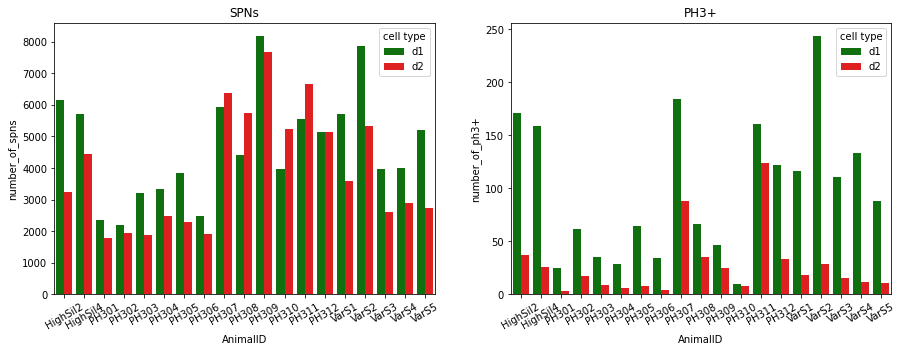

In [12]:
all_sub = df[df.SPN==1].groupby(['AnimalID'])['d1', 'd2'].sum()
all_sub = all_sub.reset_index()
all_sub = all_sub.melt(id_vars=["AnimalID"], 
                       var_name="cell type", 
                       value_name="number_of_spns")

ph3_sub = df[df.PH3==1].groupby(['AnimalID'])['d1', 'd2'].sum()
ph3_sub = ph3_sub.reset_index()
ph3_sub = ph3_sub.melt(id_vars=["AnimalID"], 
                       var_name="cell type", 
                       value_name="number_of_ph3+")

all_sub['dataset'] = 'all cells'
ph3_sub['dataset'] = 'ph3 cells'

sns.set_palette(['green','red'])
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(15,5))
sns.barplot(x='AnimalID', y='number_of_spns', hue='cell type', data=all_sub, ax=ax1)
sns.barplot(x='AnimalID', y='number_of_ph3+', hue='cell type', data=ph3_sub, ax=ax2)
ax1.set_title('SPNs')
ax2.set_title('PH3+')
ax1.set_xticklabels(ax.get_xticklabels(),rotation = 30)
ax2.set_xticklabels(ax.get_xticklabels(),rotation = 30)

plt.savefig(processed_data_path + 'Number_bar-graph.pdf', transparent=True, bbox_inches='tight')
plt.show()

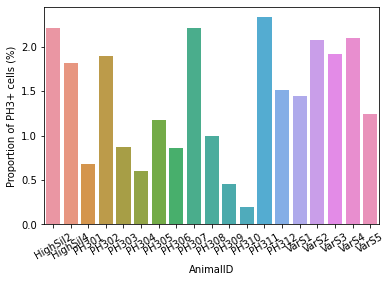

In [13]:
mixed_df = all_sub.merge(ph3_sub, on=['AnimalID', 'cell type']).groupby(['AnimalID']).sum()
mixed_df = mixed_df.reset_index()
mixed_df['proportion'] = mixed_df['number_of_ph3+'] / mixed_df['number_of_spns'] * 100
ax = sns.barplot(x='AnimalID', y='proportion', data=mixed_df)
ax.set(ylabel='Proportion of PH3+ cells (%)')
ax.set_xticklabels(ax.get_xticklabels(),rotation = 30)
plt.savefig(processed_data_path + 'Proportion_of_ph3.pdf', transparent=True, bbox_inches='tight')
plt.show()

## Visualization

In [2]:
# Indicate the animal IDs you want to load
animals_to_load = ['PH307', 'PH308', 'PH310', 'PH309', 'PH311', 'PH312']
animals_to_load = animals_to_load + [''.join(['VarS', str(x)]) for x in range(1,6)]
animals_to_load = animals_to_load + ['HighSil2', 'HighSil4']
# Indicate the main path where all processed data is
processed_data_path = '/home/hernandom/data/Microscopy_Data/Plasticity/PH3_inmuno/Processed_data/'

In [3]:
# loop through the animals to get the dataset
df_list = []
for animal_to_load in animals_to_load:
# get paths
    output_directory = os.path.join(processed_data_path, animal_to_load, 'Analysis')
    # read it
    df = pd.read_pickle(os.path.join(output_directory, animal_to_load + '_ph3_cells.pkl'))
    # Add the data path as an attribute of the dataframe because it might have changed computers
    df.attrs['datapath'] = processed_data_path
    # append
    df_list.append(df)
# concatenate data frames
df = pd.concat(df_list, ignore_index=True)

In [4]:
# load the initial dataset
first_batch_df = pd.read_pickle(os.path.join(processed_data_path, 'PH301-PH302-PH303-PH304-PH305-PH306_ph3_cells.pkl'))
# get the ARA cell positions
first_batch_ARA = pd.read_csv(os.path.join(processed_data_path, 'PH301-PH302-PH303-PH304-PH305-PH306_ph3_cells_ARA_coordinates.csv'))
# rename column for the merge and remove duplicated column
first_batch_ARA = first_batch_ARA.rename(columns={'cell_index': 'df_indexes'}).drop('cell_label', axis=1)
# merge by cell index column
fb_df = pd.merge(first_batch_df, first_batch_ARA, on='df_indexes')

In [5]:
# transform the pixel values to mm

# the first batch data is assuming 25 microns per pixel
# the atlas xy size is 456 x 320 pixels
# ML coordinates
fb_df.x_coord_post = (456 - fb_df.x_coord_post) * 25 / 1000
# DV coordinates
fb_df.y_coord_post = fb_df.y_coord_post * 25 / 1000
# AP coordinates
fb_df.z_coord_post = fb_df.z_coord_post * 25 / 1000

# rename columns
fb_df = fb_df.rename(columns={
    'x_coord_post': 'ARA_ml',
    'y_coord_post': 'ARA_dv',
    'z_coord_post': 'ARA_ap'
})

In [6]:
# concatenate data frames
df = pd.concat([df, fb_df], ignore_index=True)

In [7]:
colpalette = [(0.24715576, 0.49918708, 0.57655991), (0.72162039, 0.3669119 , 0.22526315)]
sns.set_palette(colpalette)

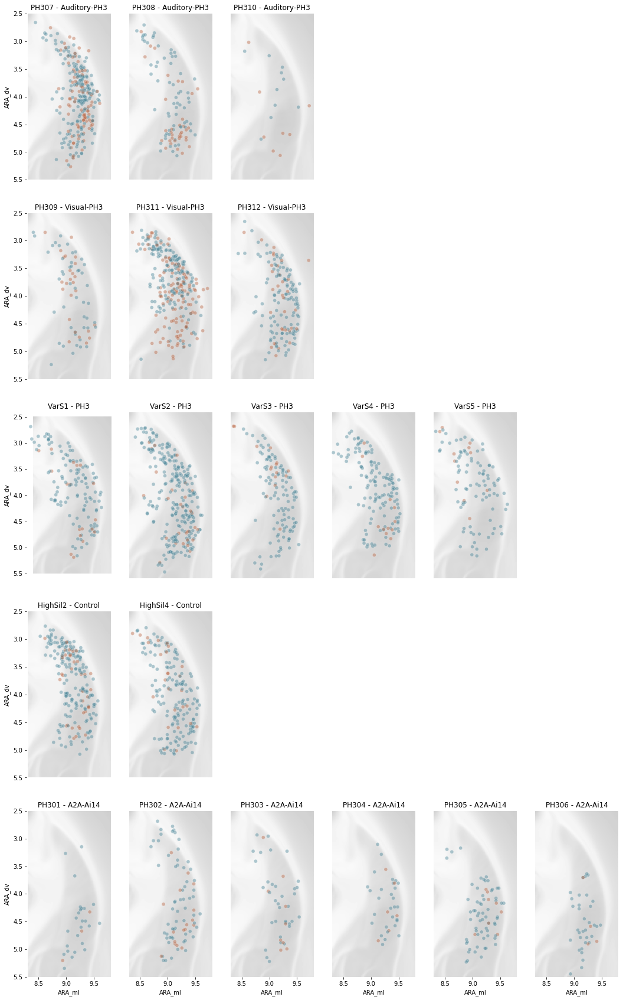

In [8]:
# plot individual animals

#TODO: add legend to plot

side_to_plot = 'both'
cell_type = 'all'

nrows = len(pd.unique(df.ExperimentalCondition))
ncols = df.groupby('ExperimentalCondition').agg({'AnimalID': 'nunique'}).max().item()
fig, axs = plt.subplots(nrows, ncols, figsize=(3 * ncols, 6 * nrows))
for ax in axs.ravel(): ax.axis('off')
for ecc, exp_cond in enumerate(pd.unique(df.ExperimentalCondition)):
    exp_df = df[df.ExperimentalCondition == exp_cond].copy()
    for ac, animal in enumerate(pd.unique(exp_df.AnimalID)):
        an_df = exp_df[exp_df.AnimalID == animal].copy()
        ax = axs[ecc, ac]
        # remove some ticks
        ax.tick_params(which='both', top=False, bottom='on', left='on', right=False,
                       labelleft='on', labelbottom='on')
        if not ax.get_subplotspec().is_first_col():
            ax.set_ylabel('')
            ax.set_yticks([])

        if not ax.get_subplotspec().is_last_row():
            ax.set_xlabel('')
            ax.set_xticks([])

        # get rid of the frame
        for spine in ax.spines.values():
            spine.set_visible(False)
        ax.axis('on')
        plot_utils.plot_cells_in_tail(an_df, ax, cell_type=cell_type, side=side_to_plot)
        ax.set_title(animal + ' - ' + exp_cond)

plt.savefig(processed_data_path + 'Cells_location_individuals_'+ cell_type + '_' + side_to_plot + '.pdf',
            transparent=True, bbox_inches='tight')
        
plt.show()

In [9]:
# merge by cohort and plot side by side
df.at[df.ExperimentalCondition=='A2A-Ai14', 'ExperimentalCondition'] = 'Auditory-PH3'

In [21]:
cond_list

['Auditory-PH3', 'Visual-PH3', 'PH3', 'Control']

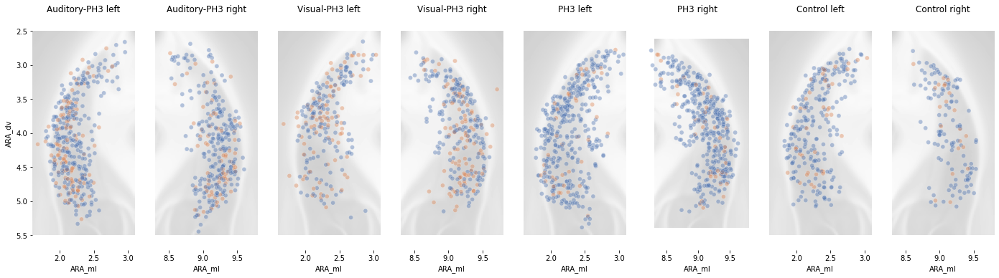

In [22]:
# merge

cond_list = list(pd.unique(df.ExperimentalCondition))

cell_type = 'all'

nrows = 1
ncols = 2 * len(cond_list)
fig, axs = plt.subplots(nrows, ncols, figsize=(3 * ncols, 6 * nrows))
for ax in axs.ravel(): ax.axis('off')
ax_counter = -1    
for ecc, exp_cond in enumerate(cond_list):
    exp_df = df[df.ExperimentalCondition == exp_cond].copy()
    for side_counter, side_to_plot in enumerate(['left' ,'right']):
        ax_counter = ax_counter + 1
        ax = axs[ax_counter]
        # remove some ticks
        ax.tick_params(which='both', top=False, bottom='on', left='on', right=False,
                       labelleft='on', labelbottom='on')
        if not ax.get_subplotspec().is_first_col():
            ax.set_ylabel('')
            ax.set_yticks([])

        if not ax.get_subplotspec().is_last_row():
            ax.set_xlabel('')
            ax.set_xticks([])

        # get rid of the frame
        for spine in ax.spines.values():
            spine.set_visible(False)
        ax.axis('on')
        
        plot_utils.plot_cells_in_tail(exp_df, ax, cell_type=cell_type, side=side_to_plot)
        ax.set_title(exp_cond + ' ' + side_to_plot)

plt.savefig(processed_data_path + 'Cells_location_grouped_'+ cell_type + '.pdf',
            transparent=True, bbox_inches='tight')
        
plt.show()

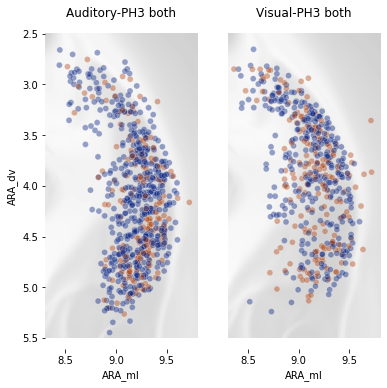

In [35]:
# merge sides
cond_list = ['Auditory-PH3', 'Visual-PH3']

cell_type = 'all'
side_to_plot = 'both'

nrows = 1
ncols = 1 * len(cond_list)

fig, axs = plt.subplots(nrows, ncols, figsize=(3 * ncols, 6 * nrows))
ax.axis('off')
ax_counter = -1    
for ecc, exp_cond in enumerate(cond_list):
    exp_df = df[df.ExperimentalCondition == exp_cond].copy()
    ax_counter += 1
    ax = axs[ax_counter]
    ax.tick_params(which='both', top=False, bottom='on', left='on', right=False,
                   labelleft='on', labelbottom='on')
    if not ax.get_subplotspec().is_first_col():
        ax.set_ylabel('')
        ax.set_yticks([])

    if not ax.get_subplotspec().is_last_row():
        ax.set_xlabel('')
        ax.set_xticks([])

    # get rid of the frame
    for spine in ax.spines.values():
        spine.set_visible(False)
    ax.axis('on')

    plot_utils.plot_cells_in_tail(exp_df, ax, cell_type=cell_type, side=side_to_plot, palette='dark')
    ax.set_title(exp_cond + ' ' + side_to_plot)

plt.savefig(processed_data_path + 'Cells_location_grouped_'+ cell_type + '_both-sides.pdf',
            transparent=True, bbox_inches='tight')
        
plt.show()

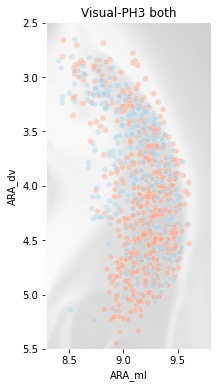

In [48]:
# overlay
my_pal1 = sns.color_palette([(0.24715576, 0.49918708, 0.57655991)])
my_pal2 = sns.color_palette([(160/255, 11/255 , 11/255)])
palette_list = ['Reds', 'Blues']

cond_list = ['Auditory-PH3', 'Visual-PH3']

sa_list = [True, False]

cell_type = 'd1'
side_to_plot = 'both'

nrows = 1
ncols = 1

fig, ax = plt.subplots(nrows, ncols, figsize=(3 * ncols, 6 * nrows))
ax.axis('off')

for ecc, exp_cond in enumerate(cond_list):
    exp_df = df[df.ExperimentalCondition == exp_cond].copy()
    ax.tick_params(which='both', top=False, bottom='on', left='on', right=False,
                   labelleft='on', labelbottom='on')
    if not ax.get_subplotspec().is_first_col():
        ax.set_ylabel('')
        ax.set_yticks([])

    if not ax.get_subplotspec().is_last_row():
        ax.set_xlabel('')
        ax.set_xticks([])

    # get rid of the frame
    for spine in ax.spines.values():
        spine.set_visible(False)
    ax.axis('on')

    plot_utils.plot_cells_in_tail(exp_df, ax, cell_type=cell_type, side=side_to_plot,
                                  palette=palette_list[ecc], show_atlas=sa_list[ecc], flip_axis=sa_list[ecc])
    ax.set_title(exp_cond + ' ' + side_to_plot)

plt.savefig(processed_data_path + 'Cells_location_grouped_'+ cell_type + '_both-sides_merged.pdf',
            transparent=True, bbox_inches='tight')
        
plt.show()

In [41]:
exp_df

,AnimalID,ExperimentalCondition,Slide,Slice,Side,AP,ROI,ObjectNumber_cells,I_cell_C2,I_cell_C3,...,SPN,d1,d2,PH3,df_indexes,cell_label,ARA_ap,ARA_dv,ARA_ml,I_C4_diff
0,PH307,Auditory-PH3,1,0,Both,Caudoputamen,10,88,0.469563,0.569905,...,1,0,1,1,87,d2,6.655107,3.813425,2.130260,NaN
1,PH307,Auditory-PH3,1,0,Both,Caudoputamen,11,10,0.515863,0.120123,...,1,1,0,1,162,d1,6.654297,3.979003,2.161178,NaN
2,PH307,Auditory-PH3,1,0,Both,Caudoputamen,13,12,0.487603,0.654127,...,1,0,1,1,479,d2,6.654081,4.562276,2.169444,NaN
3,PH307,Auditory-PH3,1,0,Both,Caudoputamen,13,89,0.529180,0.669331,...,1,0,1,1,556,d2,6.650884,4.719007,2.291544,NaN
4,PH307,Auditory-PH3,1,0,Both,Caudoputamen,15,82,0.448793,0.367364,...,1,0,1,1,866,d2,6.650140,5.264203,2.319951,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2364,PH306,Auditory-PH3,1,5,L,Tail,7,235,0.988357,0.271134,...,1,1,0,1,472126,d1,6.260714,3.636905,9.229762,NaN
2365,PH306,Auditory-PH3,1,5,L,Tail,8,230,0.618579,0.630729,...,1,1,0,1,472457,d1,6.260714,4.089286,8.958333,NaN
2366,PH306,Auditory-PH3,1,5,L,Tail,9,177,0.657693,0.336164,...,1,1,0,1,472759,d1,6.260714,4.451190,9.184524,NaN
2367,PH306,Auditory-PH3,1,5,R,Tail,15,124,0.769508,0.531896,...,1,1,0,1,474540,d1,6.260714,4.202381,2.308333,NaN


In [ ]:
# deprecated:

## Now run Histology_to_ARA repo scripts for registration (deprecated)

### TODO: Use this to select the cells based on where they are located (e.g. tail of str auditory area)


In [ ]:
# There is no sign of the gradient for now. Wait to do more experiments with the controls

In [ ]:
# read the dataframe
df = pd.read_pickle(os.path.join(processed_data_path, '-'.join(animals_to_load) + '_all_cells.pkl'))
SPN_indexes = df[df.SPN == 1].index.values
d1_SPN_indexes = df[df.d1 == 1].index.values
d2_SPN_indexes = df[df.d2 == 1].index.values
PH3_indexes = df[df.PH3 == 1].index.values

In [ ]:
plt.plot(df.loc[d1_spn_idx].I_cell_C3, df.loc[d1_spn_idx].I_surround_C3, '.g', alpha=0.05)
plt.plot(df.loc[d2_spn_idx].I_cell_C3, df.loc[d2_spn_idx].I_surround_C3, '.r', alpha=0.05)
plt.plot([0, 1], [0, 1])

In [ ]:
df_tosave = df.loc[SPN_indexes][['']]

In [ ]:
df_tosave.to_pickle('/home/hernandom/Desktop/for_Joaquin.pkl')

In [ ]:
def plot_results(X, Y_, means, covariances):
    fig, ax = plt.subplots()
    for i, (mean, covar, color) in enumerate(zip(means, covariances, color_iter)):
        v, w = np.linalg.eigh(covar)
        v = 2. * np.sqrt(2.) * np.sqrt(v)
        u = w[0] / np.linalg.norm(w[0])
        # as the DP will not use every component it has access to
        # unless it needs it, we shouldn't plot the redundant
        # components.
        if not np.any(Y_ == i):
            continue
        plt.scatter(X[Y_ == i, 0], X[Y_ == i, 1], 3, color=color, alpha=.1)
        # Plot an ellipse to show the Gaussian component
        angle = np.arctan(u[1] / u[0])
        angle = 180. * angle / np.pi # convert to degrees
        ell = mpl.patches.Ellipse(mean, v[0], v[1], 180. + angle, color='red')
        # ell.set_clip_box(plt.bbox)
        ell.set_alpha(0.3)
        ax.add_artist(ell)
        plt.xticks(())
        plt.yticks(())

In [ ]:
# Gaussian fit from Joaquin
from sklearn.mixture import GaussianMixture
import itertools
import matplotlib as mpl

color_iter = itertools.cycle(['navy', 'c', 'cornflowerblue', 'gold', 'darkorange'])
X = df_tosave.loc[df_tosave.d2==1, ["I_cell_C3", "I_surround_C3"]].to_numpy()
gmm = GaussianMixture(n_components=1, random_state=0).fit(X)
plot_results(X=X, Y_=gmm.predict(X), means=gmm.means_, covariances=gmm.covariances_)

In [ ]:
np.linalg.eigh(gmm.covariances_)

### Dumpster

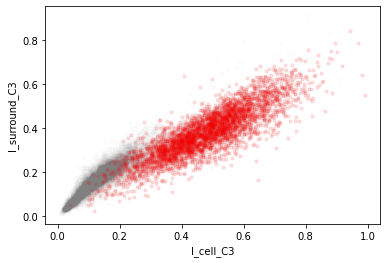

In [17]:
# d2 from cellpose
d2_indexes_cp = df[df.cellpose_d2 > 0].index.values
d2_spn_idx = np.intersect1d(SPN_indexes, d2_indexes_cp)
df.loc[SPN_indexes].plot.scatter("I_cell_C3", "I_surround_C3", alpha = 0.01, color ='grey')
plt.plot(df.loc[d2_spn_idx].I_cell_C3, df.loc[d2_spn_idx].I_surround_C3, '.r', alpha=0.1)

In [ ]:
# # now cluster the cells based on density
# from sklearn.cluster import DBSCAN

# clust = DBSCAN(eps=0.5, min_samples=1000)
# X = df.loc[d2_spn_idx][['I_cell_C3', 'I_surround_C3']]
# X = X.to_numpy().astype("float32", copy = False)
# stscaler = StandardScaler().fit(X)
# X = stscaler.transform(X)
# clust.fit(X)

In [ ]:
# # clustering results
# fig, ax = plt.subplots(1,1, figsize=(12, 5))
# colors = ['grey', 'green', 'red']
# for klass, color in zip(range(0, 2), colors[1:]):
#     ax.plot(X[clust.labels_ == klass, 0], X[clust.labels_ == klass, 1],
#                color=color, marker='.', alpha=0.3, linewidth=0)
# ax.plot(X[clust.labels_ == -1, 0], X[clust.labels_ == -1, 1], 'k+', alpha=0.1)
# ax.plot([0, 1], [0, 1], transform=ax.transAxes)
# ax.set_xlabel('tdTomato intensity inside')
# ax.set_ylabel('tdTomato intensity surround')

In [ ]:
# from sklearn.mixture import GaussianMixture as GMM
# X = df.loc[SPN_indexes][['I_cell_C3', 'I_surround_C3']]
# X = X.to_numpy().astype("float32", copy = False)
# stscaler = StandardScaler().fit(X)
# X = stscaler.transform(X)
# gmm = GMM(n_components=2).fit(X)
# labels = gmm.predict(X)
# plt.scatter(X[:, 0], X[:, 1], c=labels, s=4, alpha=0.02);

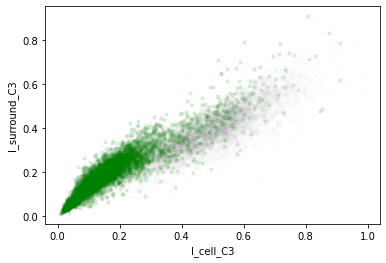

In [18]:
# d1 from cellpose
d1_spn_idx = np.setdiff1d(SPN_indexes, d2_indexes_cp)
df.loc[SPN_indexes].plot.scatter("I_cell_C3", "I_surround_C3", alpha = 0.01, color ='grey')
plt.plot(df.loc[d1_spn_idx].I_cell_C3, df.loc[d1_spn_idx].I_surround_C3, '.g', alpha=0.1)

In [ ]:
# clust = DBSCAN(eps=0.4, min_samples=1000)
# X = df.loc[d1_spn_idx][['I_cell_C3', 'I_surround_C3']]
# X = X.to_numpy().astype("float32", copy = False)
# stscaler = StandardScaler().fit(X)
# X = stscaler.transform(X)
# clust.fit(X)

In [ ]:
# # clustering results
# fig, ax = plt.subplots(1,1, figsize=(12, 5))
# colors = ['grey', 'green', 'red']
# for klass, color in zip(range(0, 2), colors[1:]):
#     ax.plot(X[clust.labels_ == klass, 0], X[clust.labels_ == klass, 1],
#                color=color, marker='.', alpha=0.3, linewidth=0)
# ax.plot(X[clust.labels_ == -1, 0], X[clust.labels_ == -1, 1], 'k+', alpha=0.1)
# ax.plot([0, 1], [0, 1], transform=ax.transAxes)
# ax.set_xlabel('tdTomato intensity inside')
# ax.set_ylabel('tdTomato intensity surround')

In [ ]:
# # see the d2 ones above the diagonal
# test_idx = np.intersect1d(d2_spn_idx, df[df.I_surround_C3 > df.I_cell_C3].index.values)
# # see the d1 ones below the diagonal
# test_idx = np.intersect1d(d1_spn_idx, df[df.I_surround_C3 <= df.I_cell_C3].index.values)


# ncells = 50
# shuffledIdx = df.loc[test_idx].index.values.copy()
# # shuffle them
# np.random.shuffle(shuffledIdx)
# shuffledIdx = shuffledIdx[0:ncells]
# fig = plt.subplots(sharey=False, figsize=(15,np.ceil(2*ncells)))
# for counter, i in enumerate(shuffledIdx):
#     CellImage = plot_utils.plotPH3Cell(df.loc[i], os.path.join(processed_data_path, df.loc[i].AnimalID),
#                                        window=60, lut='plasma')
#     plt.subplot(ncells, 1, counter+1)
#     plt.grid(False)
#     plt.axis('off')
#     plt.title(str(i))
#     plt.imshow(CellImage)


In [ ]:
# # An alternative is to select those cells that are above X sd
# mu_d1 = np.mean(df.loc[d1_SPN_indexes].I_cell_C4)
# std_d1 = np.std(df.loc[d1_SPN_indexes].I_cell_C4)
# mu_d2 = np.mean(df.loc[d2_SPN_indexes].I_cell_C4)
# std_d2 = np.std(df.loc[d2_SPN_indexes].I_cell_C4)

# sns.histplot(data=df.loc[d1_SPN_indexes], x='I_cell_C4', color='green', binwidth=.01, kde=False, log_scale=(False,False))
# sns.histplot(data=df.loc[d2_SPN_indexes], x='I_cell_C4', color='red', binwidth=.01, kde=False, log_scale=(False,False))
# plt.axvline(mu_d1 + 4 * std_d1, color='green')
# plt.axvline(mu_d2 + 4 * std_d2, color='red')

In [113]:
# splot = sns.histplot(data=df.loc[SPN_indexes], x='I_cell_C4_norm', color='green', binwidth=.005)
# splot.set(yscale="log")
# plt.axvline(mu_int + sig_crit * std_int)
# plt.show()

In [114]:
# splot = sns.histplot(data=df.loc[SPN_indexes], x='I_C4_diff', color='green', binwidth=.005)
# splot.set(yscale="log")
# plt.axvline(mu_diff + sig_crit * std_diff)
# plt.show()

In [115]:
# # define parameters for selection of ph3 cells
# c4_point = [0.7, 0.7]
# c4_slope = 1
# xs = np.linspace(np.min(df.I_cell_C4_norm), np.max(df.I_cell_C4_norm), 10)

# zero_int = c4_point[1] - c4_point[0] * c4_slope

# ys = zero_int + xs * c4_slope

# df.loc[SPN_indexes].plot.scatter("I_cell_C4_norm", "I_surround_C4", alpha = 0.050)
# plt.plot(c4_point[0], c4_point[1], '.r')
# # plt.plot([c4_point[0], np.max(df.I_cell_C4_norm)],
# #          [c4_point[1], zero_int + np.max(df.I_cell_C4_norm) * c4_slope],
# #          '-', color='orange')
# plt.plot([c4_point[0], c4_point[0]],
#          [np.min(df.I_surround_C4), c4_point[1]],
#          '-', color='orange')
# plt.plot(xs, ys, color='orange')
# plt.show()

In [65]:
### CLEAN ALL THIS


# apply the selection
# find indexes of PH3 cells
PH3_indexes_all = df[np.logical_and(df.I_cell_C4_norm >= c4_point[0], (df.I_cell_C4_norm * c4_slope + zero_int) >= df.I_surround_C4)].index.values
PH3_indexes = np.intersect1d(SPN_indexes, PH3_indexes_all)
df.loc[PH3_indexes].shape

(12, 23)

In [63]:
from scipy.stats import gaussian_kde as gkde

nan_mask = np.isnan(df.loc[SPN_indexes].I_cell_C4_norm)
mixed_mask = SPN_indexes[-nan_mask]

kx = np.array(df.loc[mixed_mask].I_cell_C4_norm)
ky = np.array(df.loc[mixed_mask].I_surround_C4)

kernel = gkde(np.vstack([kx, ky]))

In [66]:
xmin = kx.min()
xmax = kx.max()
ymin = ky.min()
ymax = ky.max()

In [74]:
X, Y = np.mgrid[xmin:xmax:500j, ymin:ymax:500j]
positions = np.vstack([X.ravel(), Y.ravel()])
Z = np.reshape(kernel(positions).T, X.shape)

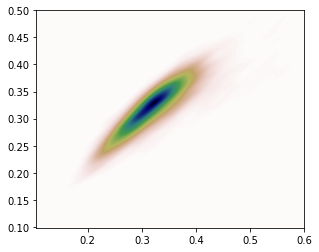

In [76]:
fig, ax = plt.subplots()
ax.imshow(np.rot90(Z), cmap=plt.cm.gist_earth_r,
          extent=[xmin, xmax, ymin, ymax])
# ax.plot(kx, ky, 'k.', markersize=1, alpha=.01)
ax.set_xlim([xmin, .6])
ax.set_ylim([ymin, .5])
plt.show()

In [ ]:
from sklearn.cluster import OPTICS

clust = OPTICS(min_samples=1000, xi=.0025, min_cluster_size=.25)
X = df.loc[SPN_indexes][['I_cell_C3', 'I_surround_C3']]
clust.fit(X)

In [ ]:
# Automatic clustering does not work as densities are different
# define an horizontal line to cut the reachability plot to define the clusters
hline = 17990
space = np.arange(len(X))
reachability = clust.reachability_[clust.ordering_]
fig, ax = plt.subplots(1, 3, figsize=(17,5))
ax[0].plot(space[space < hline], reachability[space < hline], 'g.')
ax[0].plot(space[space >= hline], reachability[space >= hline], 'r.')
# generate labels based on this
custom_labels = np.zeros(len(X))
custom_labels[clust.ordering_[hline:]] = 1


colors = ['green', 'red']
for klass, color in zip(range(0, 2), colors):
    ax[1].plot(X.iloc[custom_labels == klass, 0], X.iloc[custom_labels == klass, 1],
               color=color, marker='.', alpha=0.1, linewidth=0)
#ax[1].plot(X.iloc[custom_labels == -1, 0], X.iloc[custom_labels == -1, 1], 'k+', alpha=0.1)
ax[1].plot([0, 1], [0, 1], transform=ax[0].transAxes)
ax[1].set_xlabel('tdTomato intensity inside')
ax[1].set_ylabel('tdTomato intensity surround')
# proportion of cells
cellprop = np.unique(custom_labels, return_counts=True)
ax[2].pie(cellprop[1], labels=cellprop[0], colors=colors) 
plt.show()

# define indexes
d1_cl_indexes = X.iloc[custom_labels == 0].index.values
d2_cl_indexes = X.iloc[custom_labels == 1].index.values

In [ ]:
#FOR AUTOMATIC CLUSTERING
# define indexes
d1_cl_indexes = X.iloc[clust.labels_ == 0].index.values
d2_cl_indexes = X.iloc[clust.labels_ == 1].index.values

# clustering results
fig, ax = plt.subplots(1,2, figsize=(17, 5))
colors = ['grey', 'green', 'red']
for klass, color in zip(range(0, 2), colors[1:]):
    ax[0].plot(X.iloc[clust.labels_ == klass, 0], X.iloc[clust.labels_ == klass, 1],
               color=color, marker='.', alpha=0.3, linewidth=0)
ax[0].plot(X.iloc[clust.labels_ == -1, 0], X.iloc[clust.labels_ == -1, 1], 'k+', alpha=0.1)
ax[0].plot([0, 1], [0, 1], transform=ax[0].transAxes)
ax[0].set_xlabel('tdTomato intensity inside')
ax[0].set_ylabel('tdTomato intensity surround')
# proportion of cells
cellprop = np.unique(clust.labels_, return_counts=True)
ax[1].pie(cellprop[1], labels=cellprop[0], colors=colors) 
plt.show()

In [ ]:
# plot some of the clustered cells
ncells = 10
shuffledIdx = X[clust.labels_ == 0].index.values.copy()
# shuffle them
np.random.shuffle(shuffledIdx)
shuffledIdx = shuffledIdx[0:ncells]
fig = plt.subplots(sharey=False, figsize=(15,np.ceil(2*ncells)))
for counter, i in enumerate(shuffledIdx):
    CellImage = plot_utils.plotPH3Cell(df.loc[i], os.path.join(processed_data_path, df.loc[i].AnimalID), window=130, lut='plasma')
    plt.subplot(ncells, 1, counter+1)
    plt.grid(False)
    plt.axis('off')
    plt.title(str(i))
    plt.imshow(CellImage)

In [ ]:
# manual selection of limits to combine with the clustering
c3_dif = 0.95

# find thresholded indexes
d2_thr_indexes = X[(X.I_cell_C3 * c3_dif) >= X.I_surround_C3].index.values
d1_thr_indexes = X[(X.I_cell_C3 / c3_dif) <= X.I_surround_C3].index.values

In [ ]:
# combine indexes
d1_SPN_indexes = np.intersect1d(d1_cl_indexes, d1_thr_indexes)
d2_SPN_indexes = np.intersect1d(d2_cl_indexes, d2_thr_indexes)

In [ ]:
# combination
xs = np.linspace(0, 1, 100)
fig, ax = plt.subplots(1,2, figsize=(17, 5))
X.plot.scatter("I_cell_C3", "I_surround_C3", alpha = 0.01, color ='grey', ax=ax[0])
ax[0].plot(xs, xs * c3_dif, '-', color='b')
ax[0].plot(xs, xs / c3_dif, '-', color='b')
#plt.plot([0, 1], [0, 1], '-b')

ax[0].plot(X.loc[d1_SPN_indexes].I_cell_C3, X.loc[d1_SPN_indexes].I_surround_C3, 'g.', alpha=.05)
ax[0].plot(X.loc[d2_SPN_indexes].I_cell_C3, X.loc[d2_SPN_indexes].I_surround_C3, 'r.', alpha=.05)

# proportion of cells
cellprop = (len(d1_SPN_indexes), len(d2_SPN_indexes), X.shape[0] - (len(d1_SPN_indexes) + len(d2_SPN_indexes)))
ax[1].pie(cellprop, labels=('d1', 'd2', 'spn'), colors=('green', 'red', 'grey')) 
plt.show()

In [ ]:
# plot the distribution to select a threshold for which ones are d1 and which ones d2
%matplotlib inline
pal = sns.cubehelix_palette(light=1, as_cmap=True)
with sns.axes_style("white"):
    sns.jointplot(x='I_cell_C2',
                  y='I_cell_C3',
                  data=df.loc[SPN_indexes],
                  kind="hex",
                  #bins='log',
                  # cmap=pal,
                  joint_kws=dict(gridsize=30),
                  color='k',
                  ratio=6,
                  marginal_kws=dict(bins=25, rug=False))


In [ ]:
# define parameters for selection of spn cells
c2_thr = 0.75
c2_dif = 0.8
xs = np.linspace(c2_thr, 1, 100)

df.plot.scatter("I_cell_C2", "I_surround_C2", alpha = 0.05)
plt.plot([0, 1], [0, 1], '-r')
plt.plot([c2_thr, c2_thr], [0, c2_thr * c2_dif], '-', color='orange')
plt.plot(xs, xs * c2_dif, '-', color='orange')

#### manual selection

In [ ]:
# define parameters for selection of d2 cells
c3_thr_for_d1 = 0.43
c3_thr_for_d2 = 0.65
c3_dif_for_d2 = 0.95

#for KAA706
c3_thr_for_d1 = 0.35
c3_thr_for_d2 = 0.45
c3_dif_for_d2 = 0.95

xs = np.linspace(c3_thr_for_d2, 1, 100)


df.loc[SPN_indexes].plot.scatter("I_cell_C3", "I_surround_C3", alpha = 0.05)
plt.plot([c3_thr_for_d1, c3_thr_for_d1], [0, 1], '-', color='green')
plt.plot([c3_thr_for_d2, c3_thr_for_d2], [0, c3_thr_for_d2 * c3_dif_for_d2], '-', color='orange')
plt.plot(xs, xs * c3_dif_for_d2, '-', color='orange')
plt.plot([0, 1], [0, 1], '-r')
plt.show()

# find their indexes
d1_indexes = df[df.I_cell_C3 <= c3_thr_for_d1].index.values
d2_indexes = df[np.logical_and(df.I_cell_C3 >= c3_thr_for_d2,
                               (df.I_cell_C3 * c3_dif_for_d2) >= df.I_surround_C3)].index.values

# combine them with the SPNs
d1_SPN_indexes = np.intersect1d(SPN_indexes, d1_indexes)
d2_SPN_indexes = np.intersect1d(SPN_indexes, d2_indexes)

# percentage of d2 cells
d2_num = len(d2_SPN_indexes)
d1_num = len(d1_SPN_indexes)
100 * d2_num / (d1_num + d2_num)

In [ ]:
nd2 = sum(df.loc[spn_plus_ph3_idx].MeanI_C3 >= tdtomato_thr)
nd1 = sum(df.loc[spn_plus_ph3_idx].MeanI_C3 < tdtomato_thr)
ax = plt.pie([nd1, nd2], labels=['d1', 'd2'], colors=['cyan', 'red'],
             autopct='%1.1f%%', shadow=False, startangle=90)

In [ ]:
# find which cells are SPNs. Explore the threshold
sc = 'I_cell_C2'
# plot randomly sets of cells within certain values of channel 2, which is DARPP-32
thresholds = ((0, .2), (.2, .4), (.4, .6), (.6, .8), (.8, 1))
#create an empty list
indexes = []
# get the indexes of these cohorts
for tr in thresholds:
    shuffledIdx = df[np.logical_and(df[sc]>=tr[0], df[sc]<tr[1])].index.values.copy()
    # shuffle them
    np.random.shuffle(shuffledIdx)
    # append first
    indexes.append(shuffledIdx[0])
fig = plt.subplots(sharey=False, figsize=(15,np.ceil(2*len(thresholds))))
for counter, i in enumerate(indexes):
    CellImage = plot_utils.plotPH3Cell(df.loc[i], CPoutput_path, window=130, lut='plasma')
    plt.subplot(len(thresholds), 1, counter+1)
    plt.grid(False)
    plt.axis('off')
    plt.title(str(thresholds[counter]) + " - " + str(i))
    plt.imshow(CellImage)

In [ ]:
# circle a cell within its original image
# indicate the index of the cell
index_of_cell = spn_plus_ph3_idx[1]
# indicate the size of the circle
cir_radius = 80

imdir = os.path.join(df.attrs['datapath'],
                     'ROIs--Gce_processed',
                     gf.make_image_name_from_series(df.loc[index_of_cell], channel=4))
# find coordinates of cells
c_x = df.loc[index_of_cell].Center_X
c_y = df.loc[index_of_cell].Center_Y
# define coordinates of circle
cir_coord = (c_x - cir_radius, c_y - cir_radius, c_x + cir_radius, c_y + cir_radius)

im = Image.open(imdir)
im = im.convert('RGB')
#draw = ImageDraw.Draw(im)
plot_utils.draw_ellipse(im, cir_coord, outline ='red', width=20)
im

In [ ]:
# Plot slice for registration. this is very low res

# set the conditions to get the data of one of the ROIs
sel_animal = 'PH301'
sel_slide = '1'
sel_slice = '5'
sel_side = 'R'
conditions = np.logical_and(np.logical_and(df.AnimalID == sel_animal, df.Slide == sel_slide),
                            df.Slice == sel_slice)
# plot the slice for registration
img16 = plot_utils.get_reg_image(df[conditions])
img8 = (np.array(img16)/256).astype('uint8')
img8 = img8/np.max(img8)
im = Image.fromarray(np.uint8(img8*255))
im = ImageOps.autocontrast(im, cutoff=.01)
im
# crop it to the manual ROI

# plot the circles

In [ ]:
np.max(im)